# Test image segmentation with clustering

In [1]:
import logging
import importlib
import numpy as np
import tensorflow as tf

from tqdm import tqdm
from scipy import ndimage
from sklearn.metrics import *

from utils import *
from models import *
from datasets import *
from utils.med_utils import *

logger = logging.getLogger(__name__)

tf.config.set_visible_devices(tf.config.list_physical_devices('GPU')[:1], 'GPU')
#tf.config.set_visible_devices([], 'GPU')

model_name = 'cluster_unet_cosine'

model = get_pretrained(model_name)

2023-05-05 11:22:59.158988: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-05 11:22:59.257327: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-05-05 11:22:59.281820: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
/etinfo/users2/qlanglois/.local/lib/python3.9/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is requir

Model restoration...
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for groups will be overwritten.
The given value for

2023-05-05 11:23:12.007465: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-05 11:23:12.382158: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1616] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 14783 MB memory:  -> device: 0, name: Quadro RTX 5000, pci bus id: 0000:17:00.0, compute capability: 7.5


Initializing submodel : `model` !
Optimizer 'model_optimizer' initilized successfully !
Successfully restored model from pretrained_models/cluster_unet_cosine/saving/model.json !
[WARNING] Some layers have not bene restored from the checkpoint ! Run `model.load_checkpoint().assert_consumed()` to check if it is a critical error or not
Model cluster_unet_cosine initialized successfully !


In [2]:
dataset = get_dataset('total_segmentator')
organs  = dataset.loc[0, 'label']

print('Dataset length : {} - # labels : {}'.format(len(dataset), len(organs)))

Loading dataset total_segmentator...
Dataset length : 1203 - # labels : 104


## inference

In [3]:
row    = dataset.loc[0]

inputs, output = model.encode_data(row)
inputs = tf.expand_dims(inputs, axis = 0)
#image  = tf.expand_dims(model.get_input(row), axis = 0)
#target = model.get_output(row)
with tf.device('cpu'):
    mask = tf.argmax(tf.pad(tf.sparse.to_dense(output), [(0, 0), (0, 0), (0, 0), (1, 0)]), axis = -1).numpy()

print('Input shape : {} - Output shape : {} - Mask shape : {}'.format(inputs.shape, output.shape, mask.shape))

pred = model.infer(inputs, 64)

print('Prediction shape : {}'.format(pred.shape))

Input shape : (1, 249, 188, 213, 1) - Output shape : (249, 188, 213, 104) - Mask shape : (249, 188, 213)
Prediction shape : (1, 249, 188, 213, 32)


# labels : 17


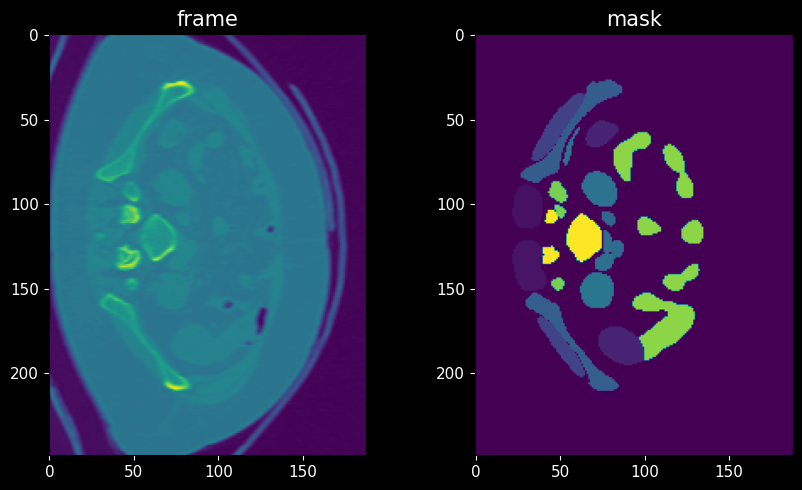

In [4]:
idx = 100

frame_inp = inputs[0, :, :, idx, 0]
frame_tar = mask[:, :, idx]
frame_emb = pred[0, :, :, idx]

frame_inp_flat = tf.reshape(frame_inp, [-1])
frame_tar_flat = np.reshape(frame_tar, [-1])
frame_emb_flat = tf.reshape(frame_emb, [-1, frame_emb.shape[-1]])

sorted_indexes = np.argsort(frame_tar_flat)

n_labels  = len(np.unique(frame_tar.reshape(-1)))
print('# labels : {}'.format(n_labels))
plot_multiple(frame = frame_inp, mask = frame_tar, plot_type = 'imshow')

In [5]:
centroids, labels = kmeans(
    frame_emb_flat, k = n_labels + 1, distance_metric = model.distance_metric
)
frame_pred = tf.reshape(labels, frame_tar.shape)
print('Centroids shape : {} - labels shape : {} - Frame pred shape : {}'.format(
    centroids.shape, labels.shape, frame_pred.shape
))

Centroids shape : (18, 32) - labels shape : (46812,) - Frame pred shape : (249, 188)


In [6]:
frame_tar_flat_sorted = frame_tar_flat[sorted_indexes]
frame_emb_flat_sorted = tf.cast(frame_emb_flat.numpy()[sorted_indexes], tf.float32)

counts = np.bincount(frame_tar_flat_sorted)
counts = counts[counts > 0]
lines  = np.cumsum(counts)

with tf.device('cpu'):
    matrix = tf_distance(
        frame_emb_flat_sorted, frame_emb_flat_sorted, method = model.distance_metric, max_matrix_size = 1024 ** 2
    ).numpy()

print('matrix shape : {}'.format(matrix.shape))

matrix shape : (46812, 46812)


## plots

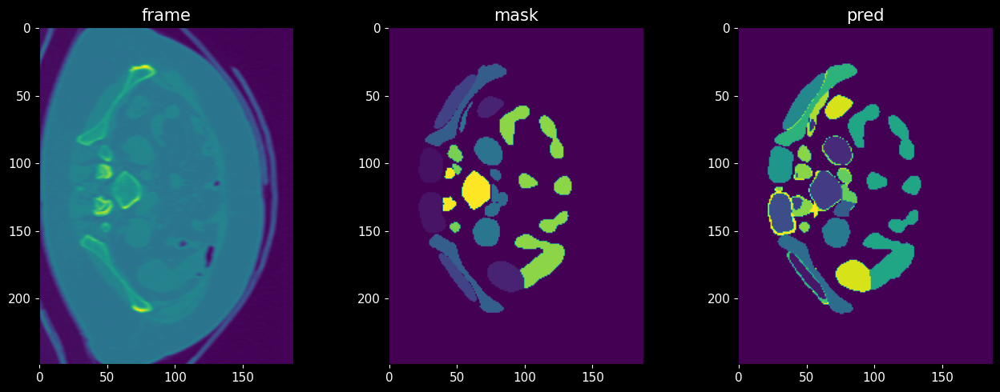

In [7]:
plot_multiple(frame = frame_inp, mask = frame_tar, pred = frame_pred, ncols = 3, plot_type = 'imshow')

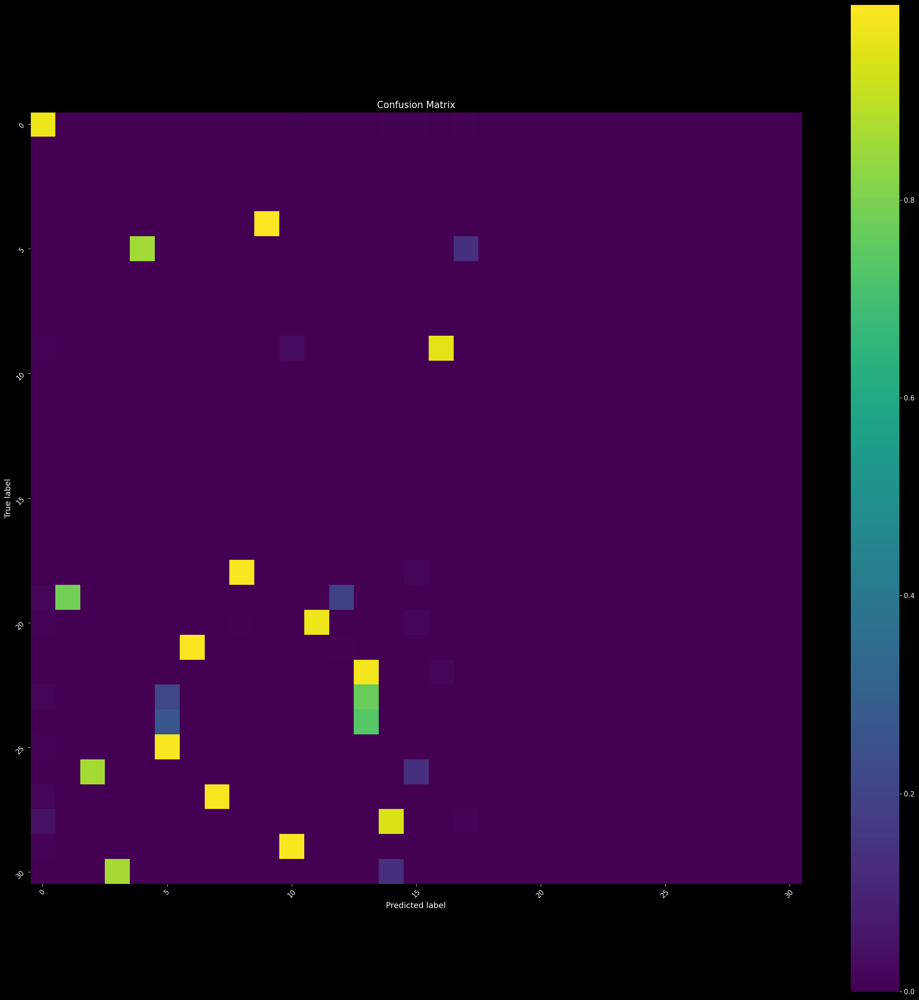

In [8]:
plot_confusion_matrix(true = frame_tar_flat, pred = labels, norm = True)

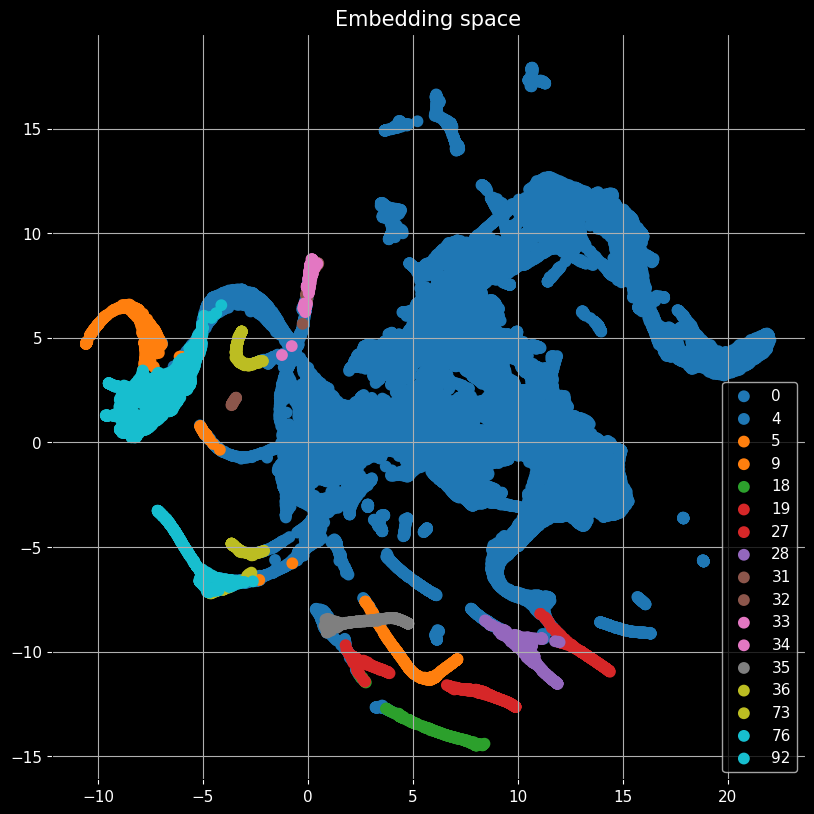

In [9]:
plot_embedding(frame_emb_flat, ids = frame_tar_flat)

In [ ]:
filename  = None
filename2 = None

plot_matrix(matrix, hlines = lines, vlines = lines, filename = filename, show = True)
plot_matrix(
    matrix[counts[0] :, counts[0] :], hlines = np.cumsum(counts[1:]), vlines = np.cumsum(counts[1:]),
    filename = filename2, show = True
)

## Similarity matrix analysis

In [ ]:
def _get_cluster_stats(matrix, s, e, threshold = 0.9):
    matrix  = matrix
    cluster = matrix[s : e, s : e]
    extra   = np.concatenate([
        matrix[s : e, : s], matrix[s : e, e :]
    ], axis = 1)
    return {
        'count_intra'        : (len(np.where(cluster.reshape(-1) >= threshold)[0]) - len(cluster)) // 2,
        'count_extra'        : len(np.where(extra.reshape(-1) > threshold)[0]),
        'min_intra_cluster'  : np.min(cluster),
        'mean_intra_cluster' : (np.sum(cluster) - len(cluster)) / (len(cluster) ** 2 - len(cluster)),
        'max_extra_cluster'  : np.max(extra),
        'mean_extra_cluster' : np.mean(extra)
    }

separators = [0] + [int(idx) for idx in lines]

stats = []
for i, (s, e) in enumerate(zip(separators[:-1], separators[1:])):
    stats.append(_get_cluster_stats(matrix, s, e))

plot_multiple(pd.DataFrame(stats), ncols = 3)
pd.DataFrame(stats)

In [ ]:
print(silhouette_score(frame_emb_flat, frame_tar_flat))
print(rand_score(frame_tar_flat, labels))
print(adjusted_rand_score(frame_tar_flat, labels))
print(evaluate_clustering(frame_tar_flat, labels))

In [ ]:
help(adjusted_rand_score)

## Tests on patches

In [3]:
row    = dataset.loc[0]

inputs, output = model.encode_data(row)
inputs = tf.expand_dims(inputs, axis = 0)
#image  = tf.expand_dims(model.get_input(row), axis = 0)
#target = model.get_output(row)
with tf.device('cpu'):
    mask = tf.argmax(tf.pad(tf.sparse.to_dense(output), [(0, 0), (0, 0), (0, 0), (1, 0)]), axis = -1).numpy()

print('Input shape : {} - Output shape : {} - Mask shape : {}'.format(inputs.shape, output.shape, mask.shape))

pred = model.infer(inputs, 64)

print('Prediction shape : {}'.format(pred.shape))

Input shape : (1, 249, 188, 213, 1) - Output shape : (249, 188, 213, 104) - Mask shape : (249, 188, 213)


2023-05-04 16:18:38.620728: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8204


Prediction shape : (1, 249, 188, 213, 32)


Analysis of patch [0 : 64, 0 : 64, 0 : 64]
Labels (n = 6) : [ 0 13 16 18 20 27]
Re-computing centroids by decreasing the k


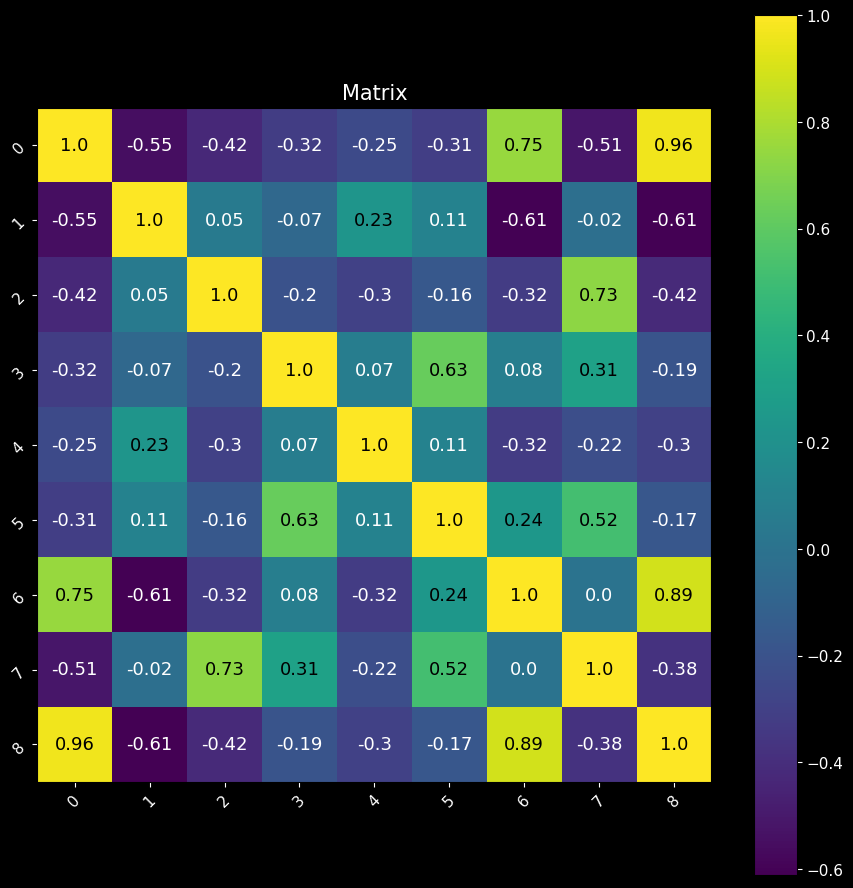

Re-computing centroids by decreasing the k


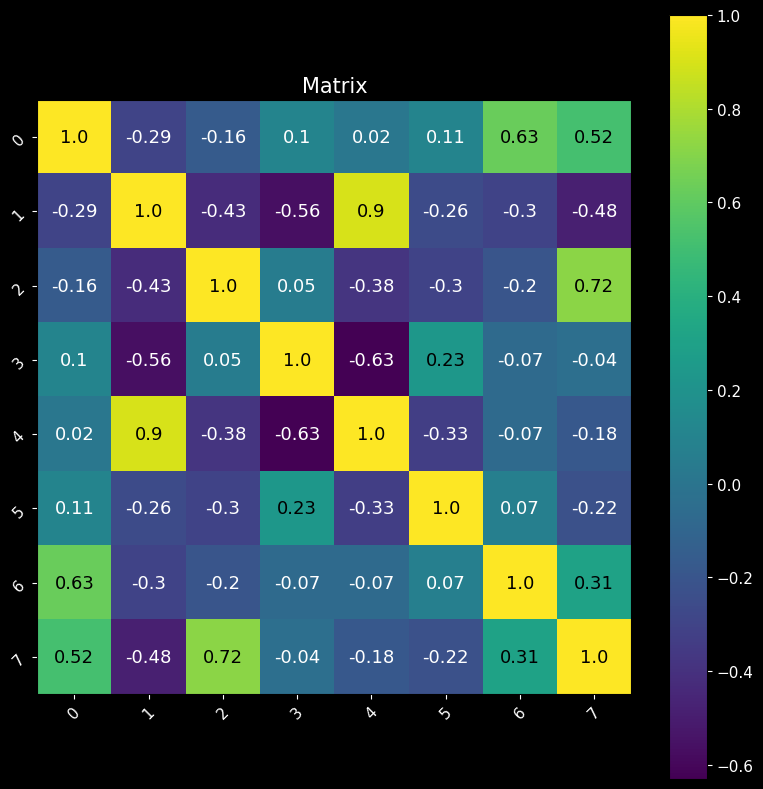

Re-computing centroids by decreasing the k


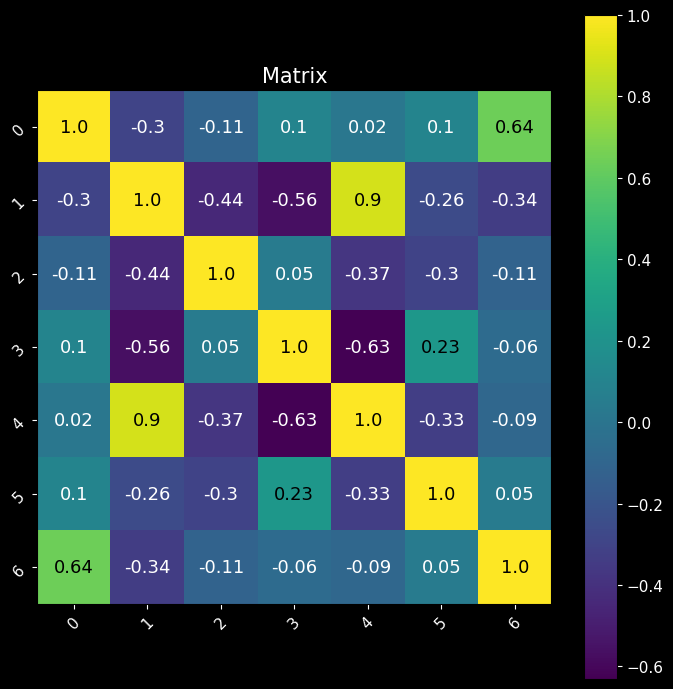

Re-computing centroids by decreasing the k


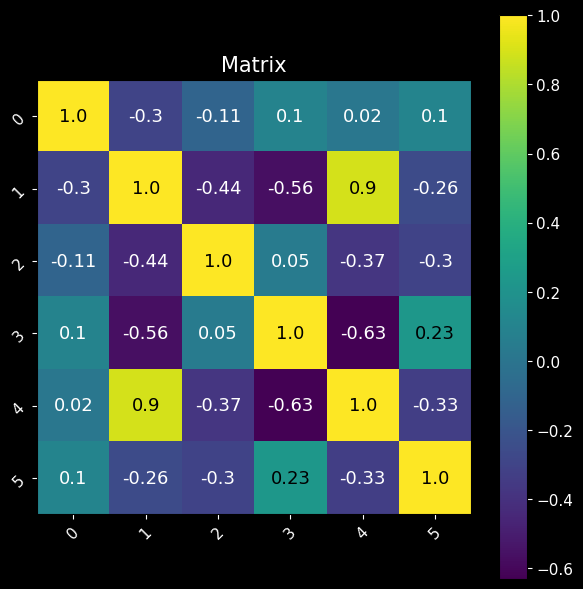

Re-computing centroids by decreasing the k


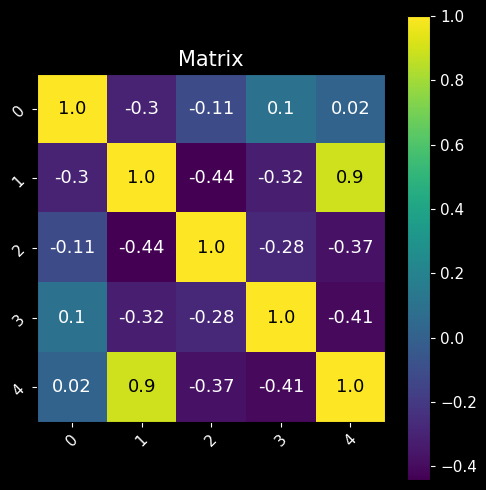

Centroids shape : (4, 32) - labels shape : (262144,) - Frame pred shape : (64, 64, 64)
Rand score             : 0.9510
Adjusted Rand score    : 0.8857
F1 score (avg = 0.5052) : ['0.984', '0.927', '0.901', '0.219', '0.000', '0.000']
Silhouette score       : 0.7003


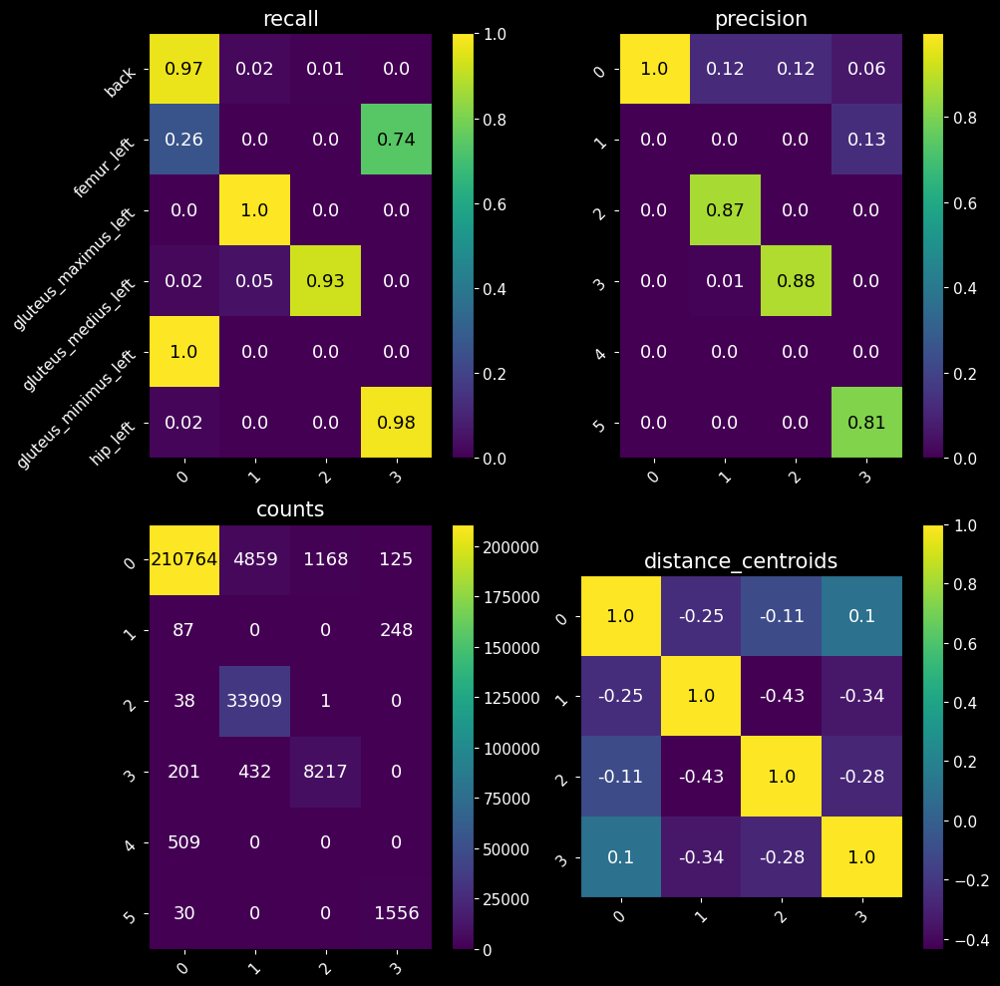

Organs matrix shape : (9046, 9046)


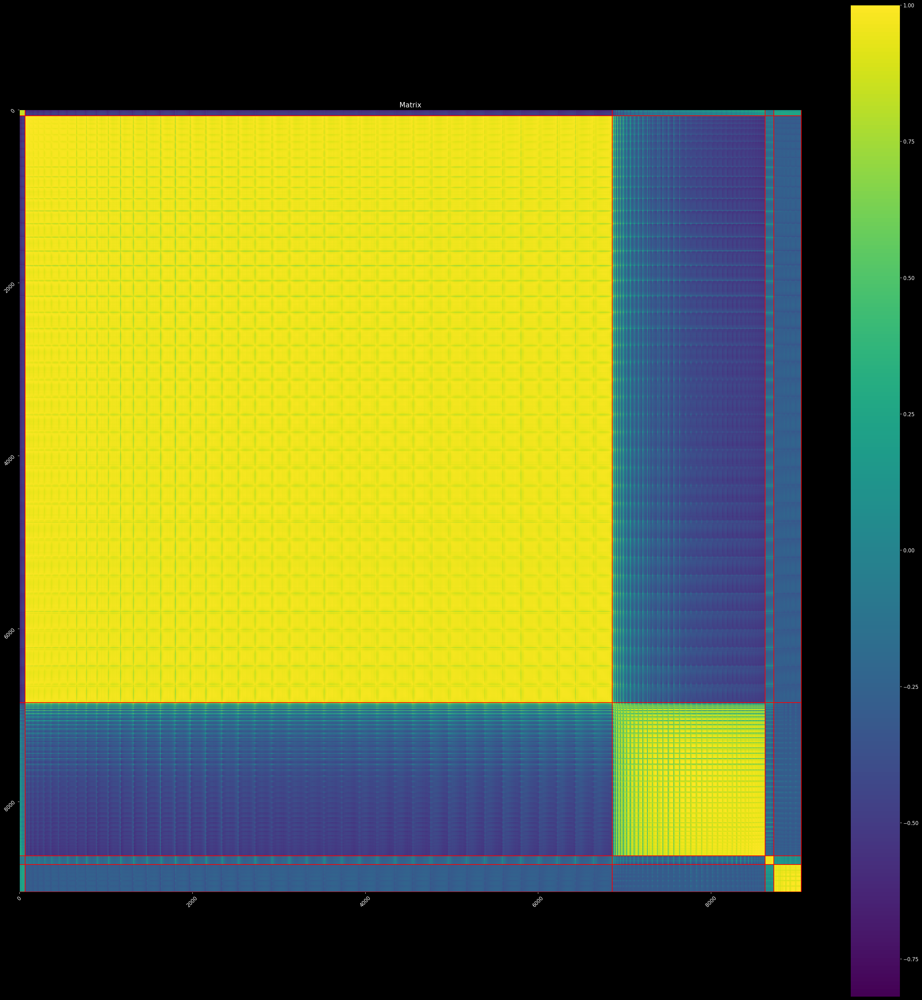


Analysis of patch [0 : 64, 0 : 64, 64 : 128]
Labels (n = 6) : [ 0 16 18 20 27 35]
Re-computing centroids by decreasing the k


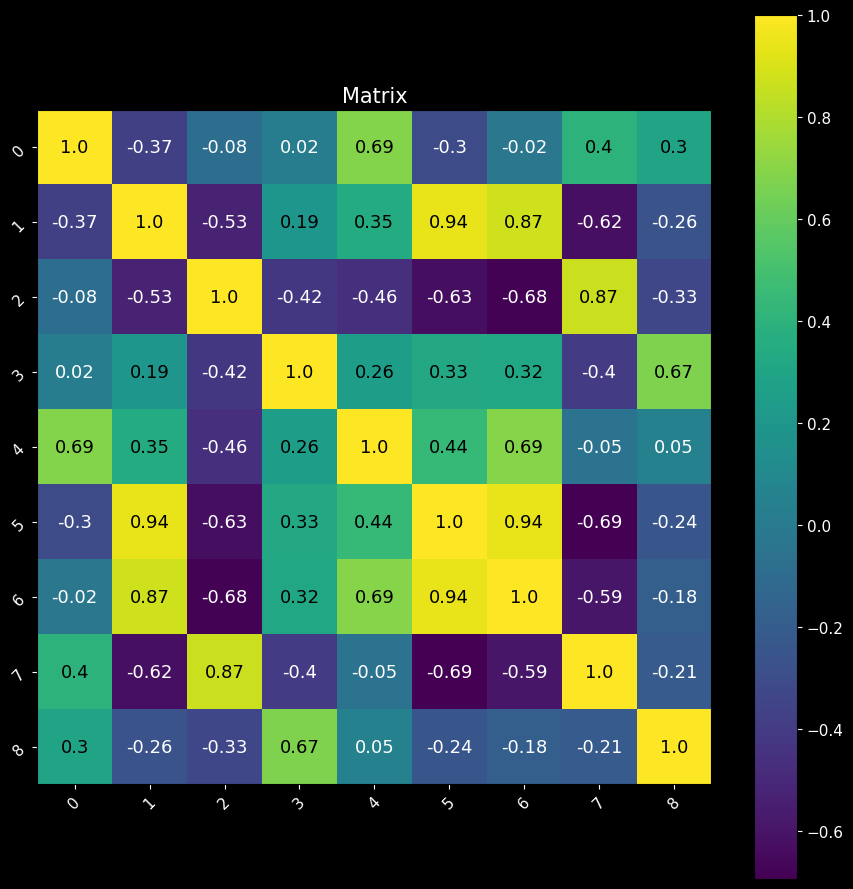

Re-computing centroids by decreasing the k


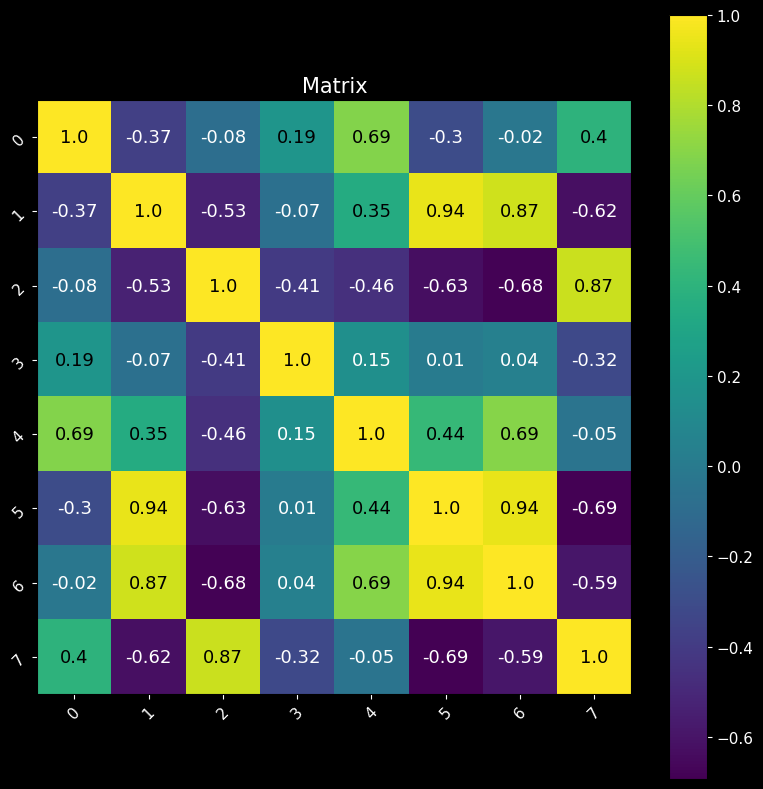

Re-computing centroids by decreasing the k


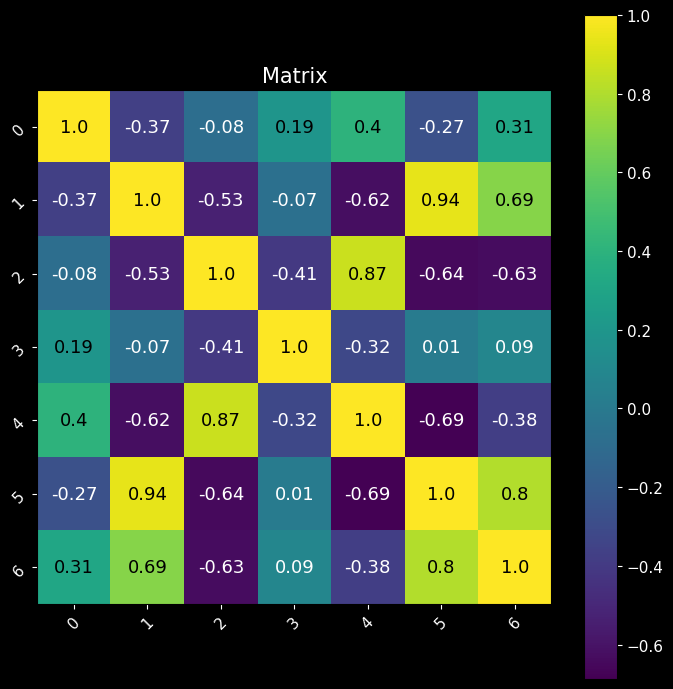

Re-computing centroids by decreasing the k


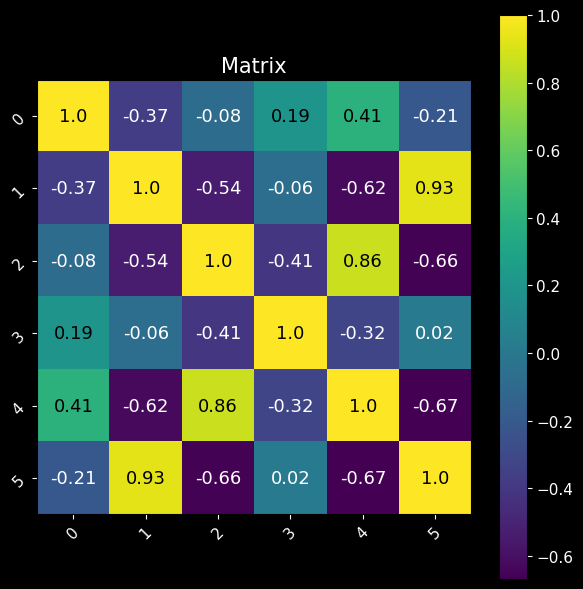

Re-computing centroids by decreasing the k


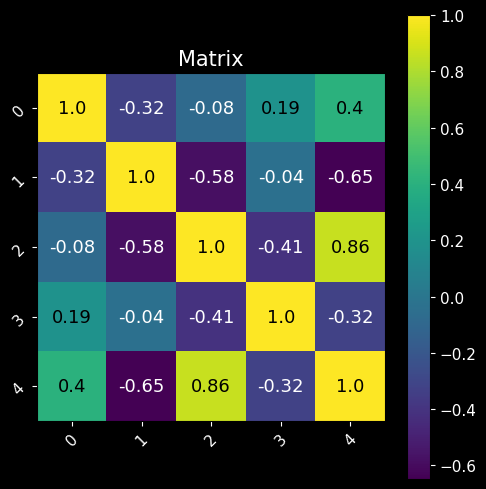

Centroids shape : (4, 32) - labels shape : (262144,) - Frame pred shape : (64, 64, 64)
Rand score             : 0.9740
Adjusted Rand score    : 0.9187
F1 score (avg = 0.6089) : ['0.992', '0.953', '0.875', '0.833', '0.000', '0.000']
Silhouette score       : 0.8881


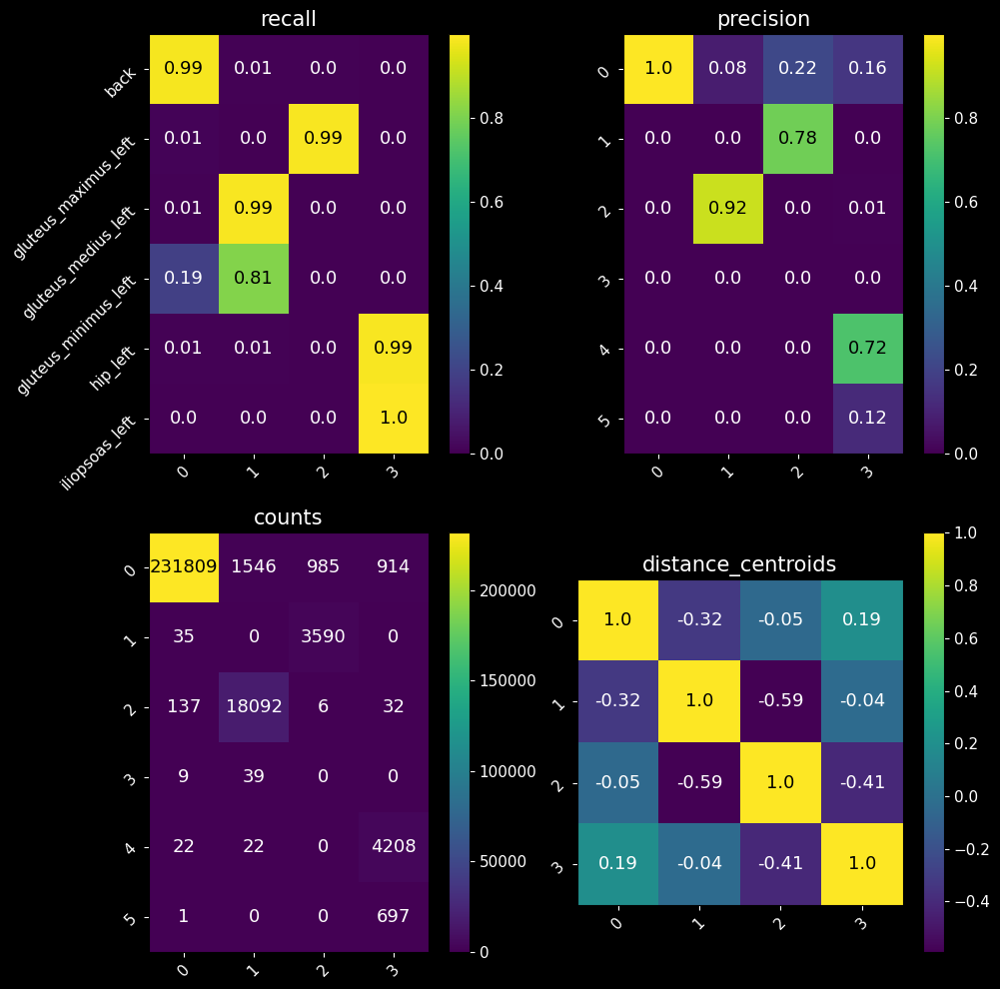

Organs matrix shape : (5378, 5378)


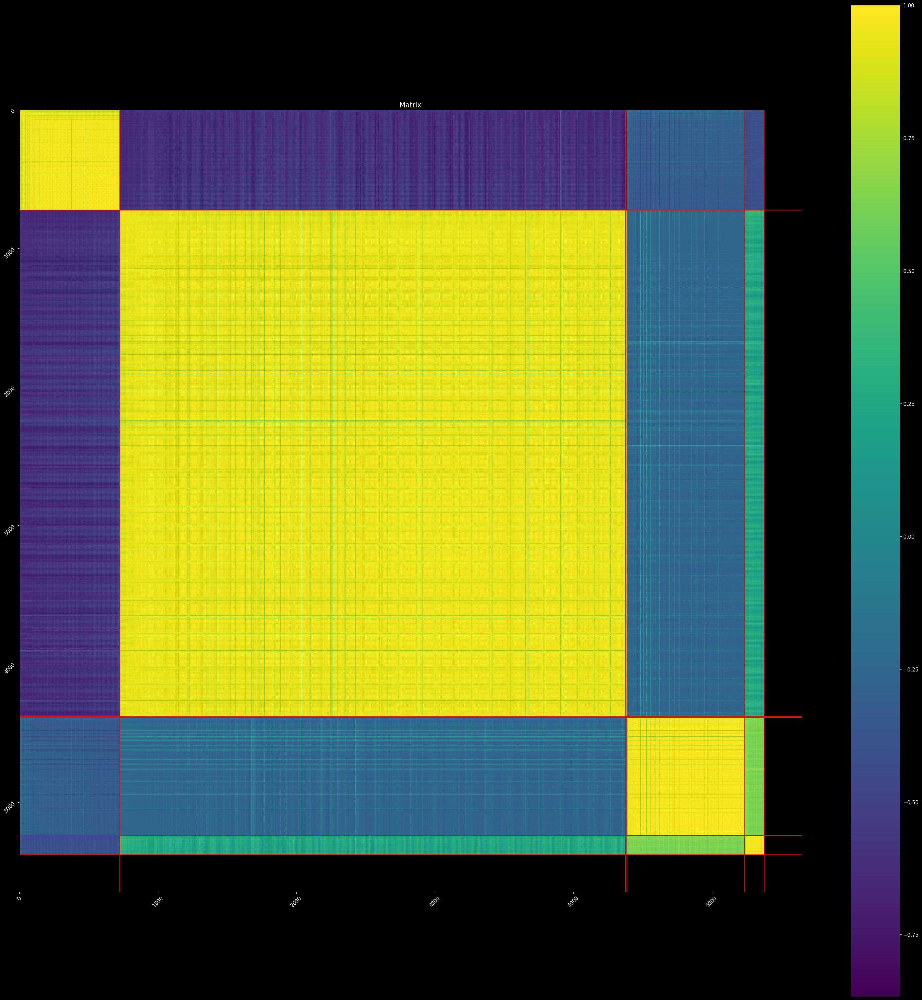


Analysis of patch [0 : 64, 0 : 64, 128 : 192]
Labels (n = 5) : [ 0 38 51 52 77]
Re-computing centroids by decreasing the k


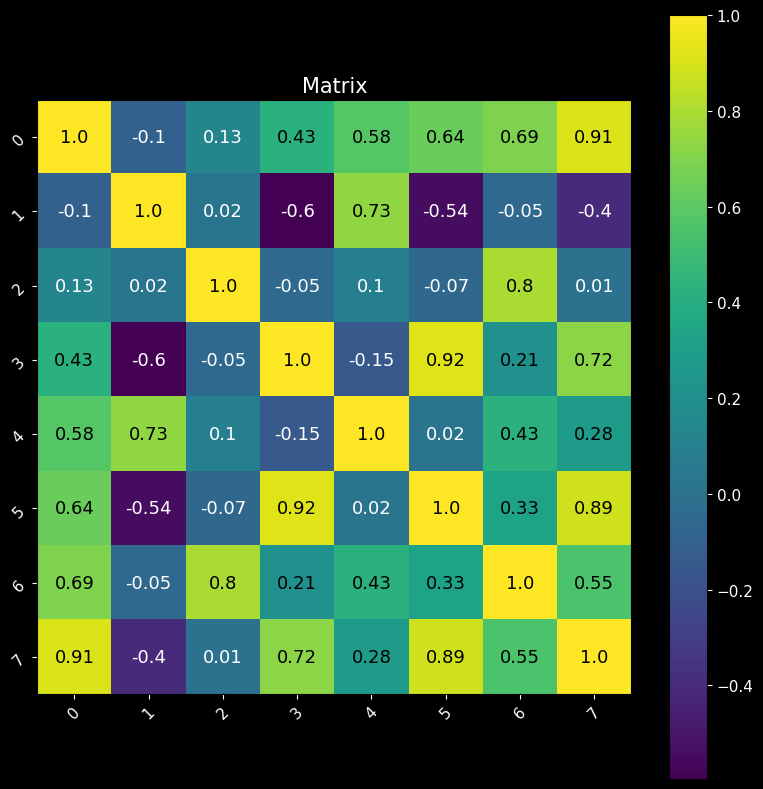

Re-computing centroids by decreasing the k


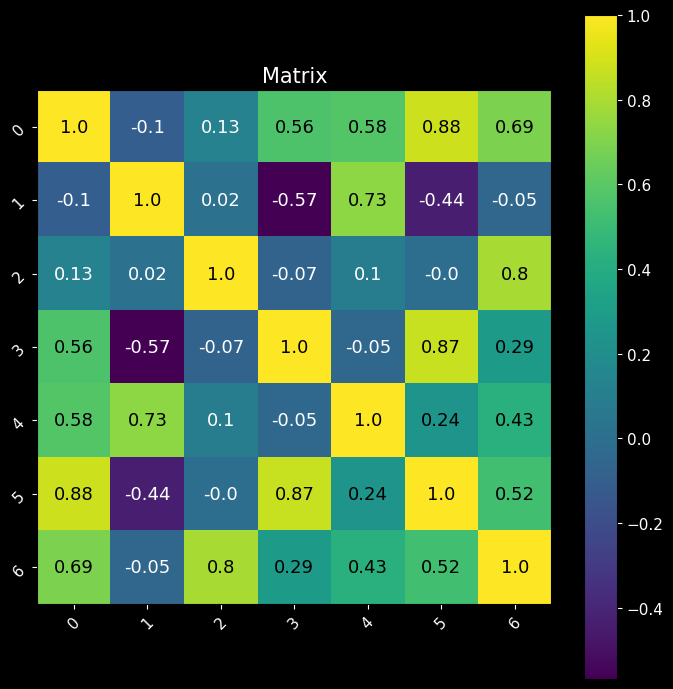

Re-computing centroids by decreasing the k


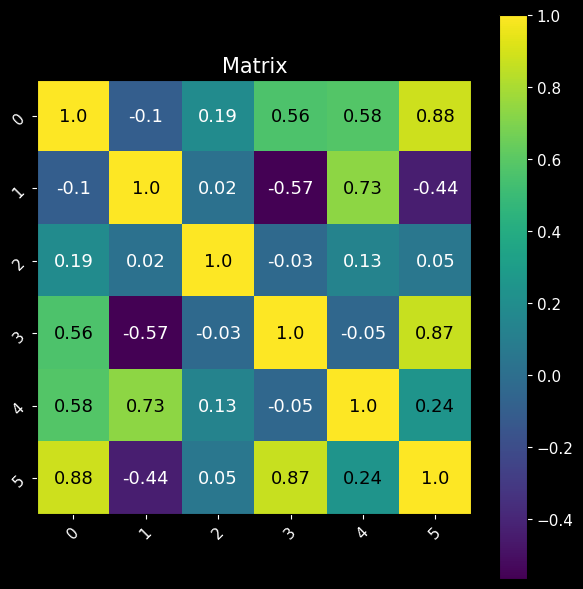

Centroids shape : (5, 32) - labels shape : (262144,) - Frame pred shape : (64, 64, 64)
Rand score             : 0.9949
Adjusted Rand score    : 0.8736
F1 score (avg = 0.6534) : ['0.999', '0.483', '0.978', '0.000', '0.808']
Silhouette score       : 0.9615


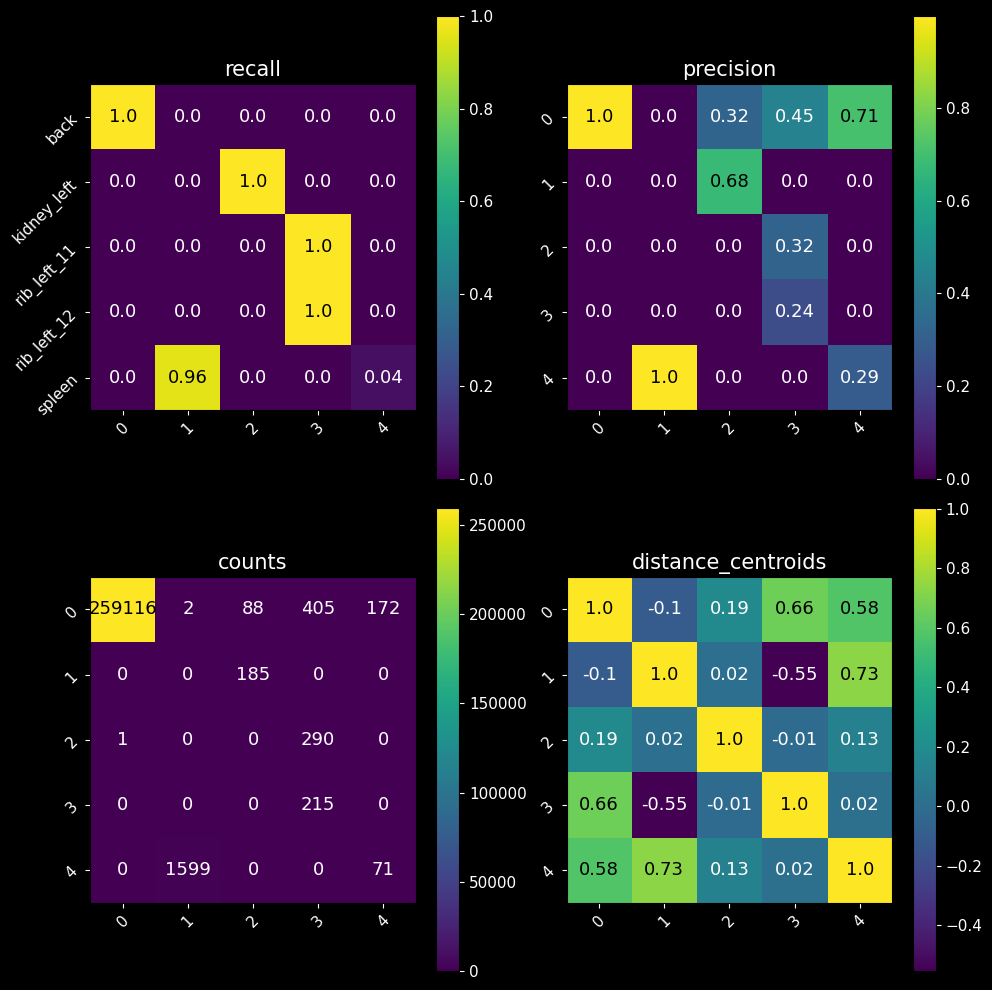

Organs matrix shape : (473, 473)


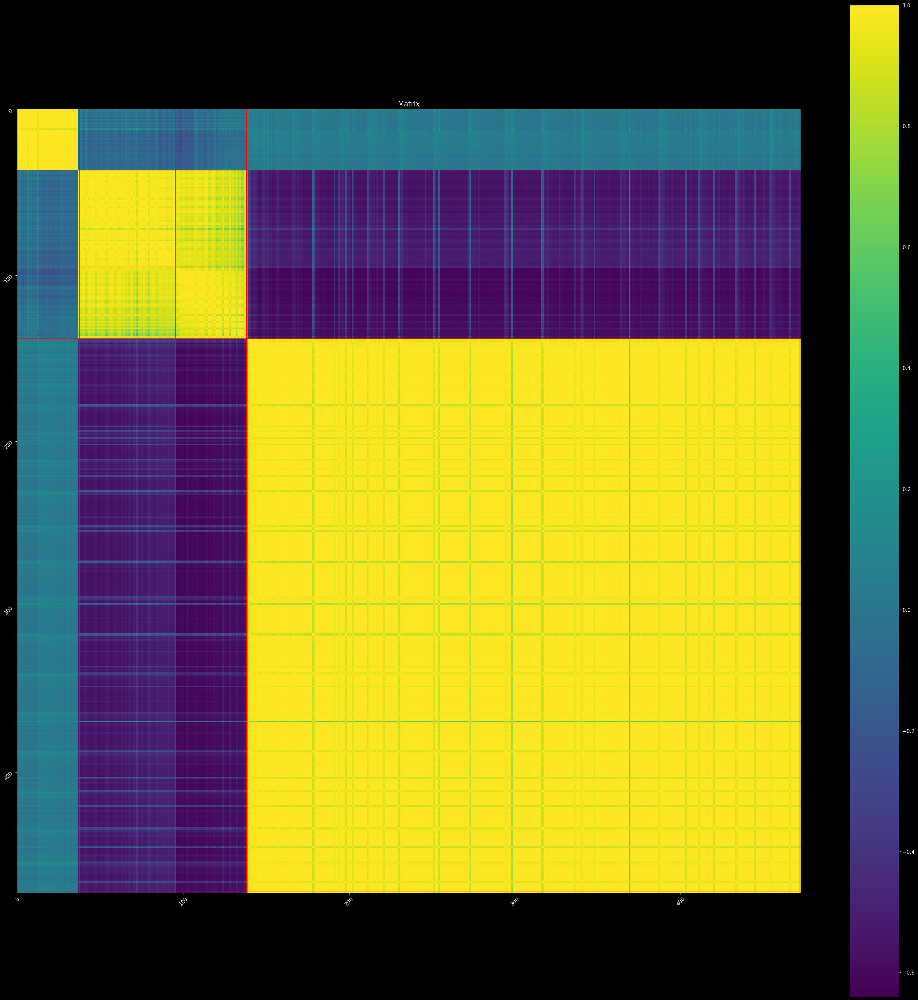


Analysis of patch [0 : 64, 0 : 64, 192 : 256]
Labels (n = 4) : [ 0 41 51 77]
Re-computing centroids by decreasing the k


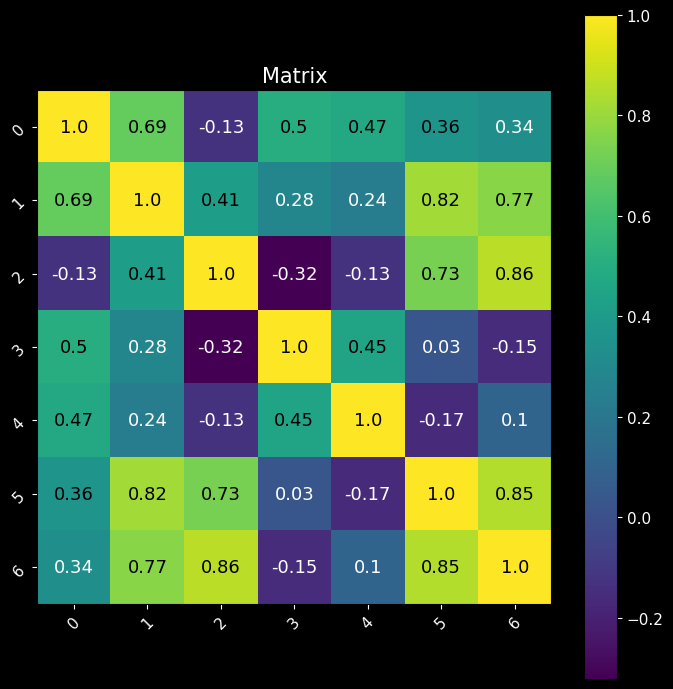

Centroids shape : (6, 32) - labels shape : (86016,) - Frame pred shape : (64, 64, 21)
Rand score             : 0.5946
Adjusted Rand score    : 0.1527
F1 score (avg = 0.5228) : ['0.843', '0.000', '0.820', '0.428']
Silhouette score       : 0.3507


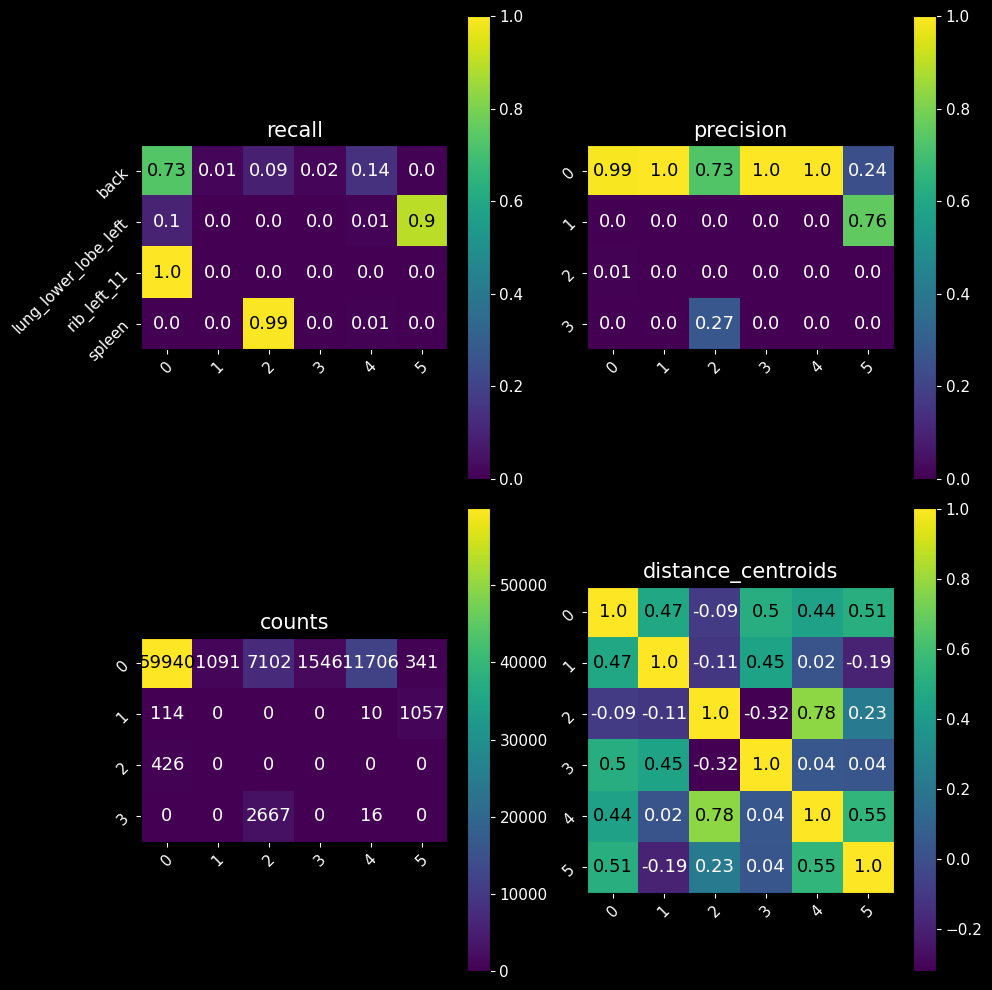

Organs matrix shape : (858, 858)


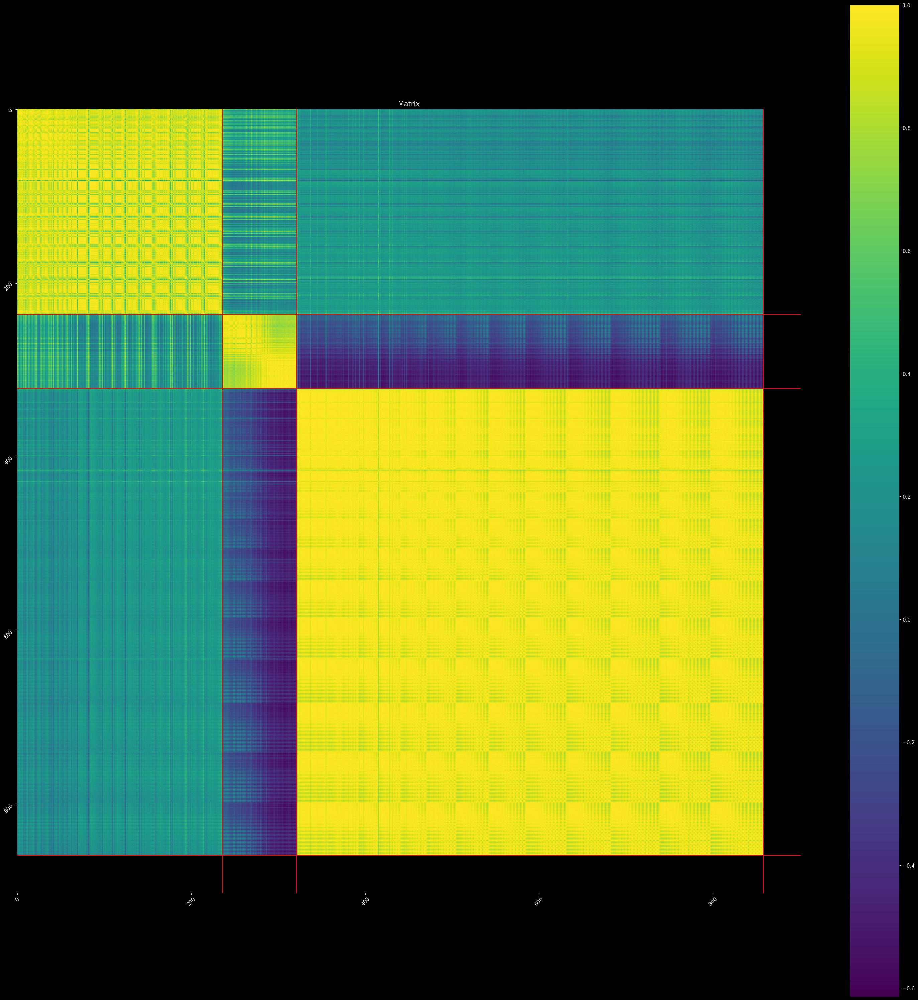


Analysis of patch [0 : 64, 64 : 128, 0 : 64]
Labels (n = 7) : [ 0 13 16 18 20 27 35]
Re-computing centroids by decreasing the k


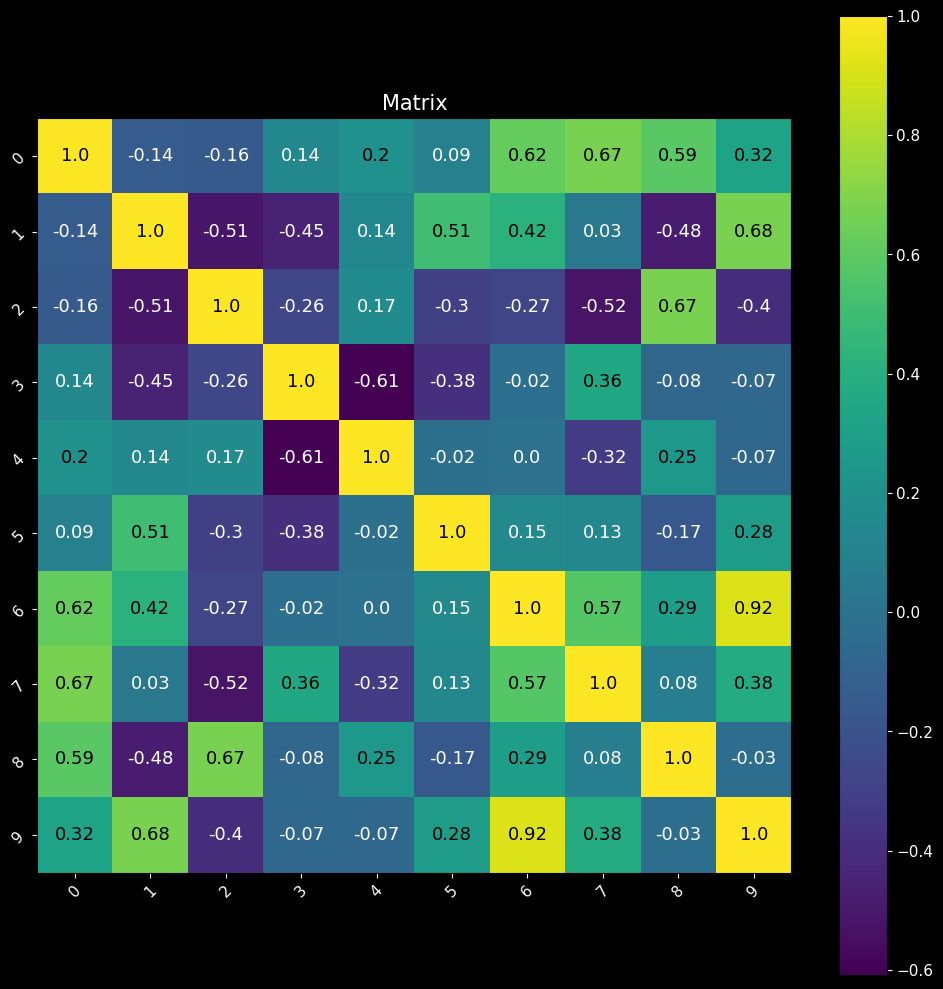

Re-computing centroids by decreasing the k


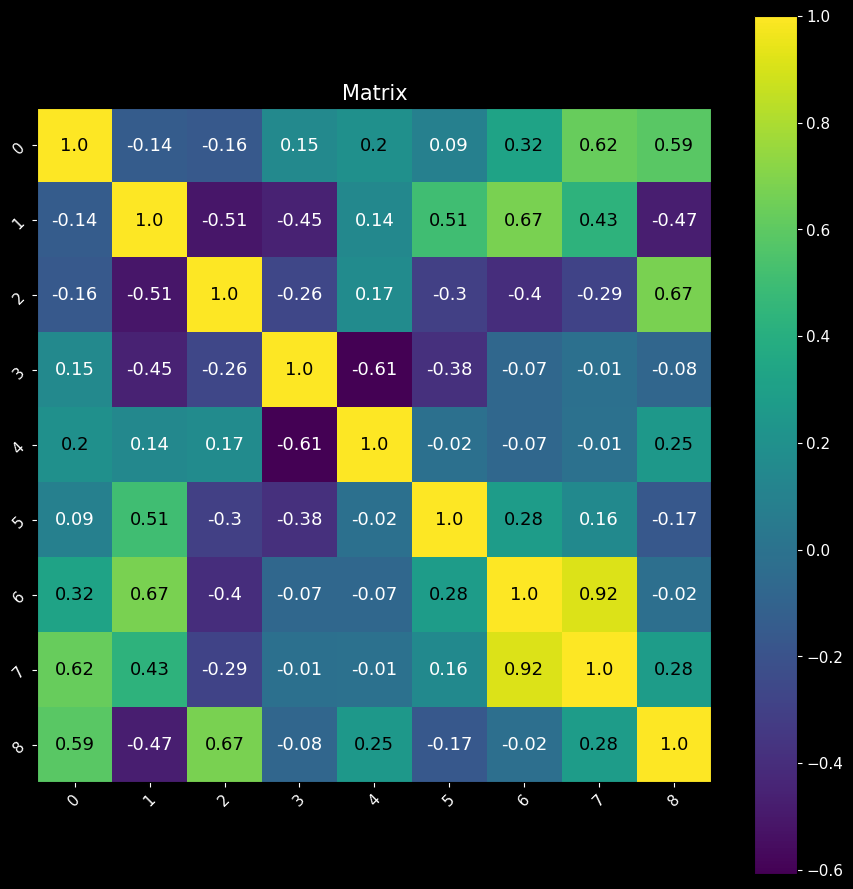

Re-computing centroids by decreasing the k


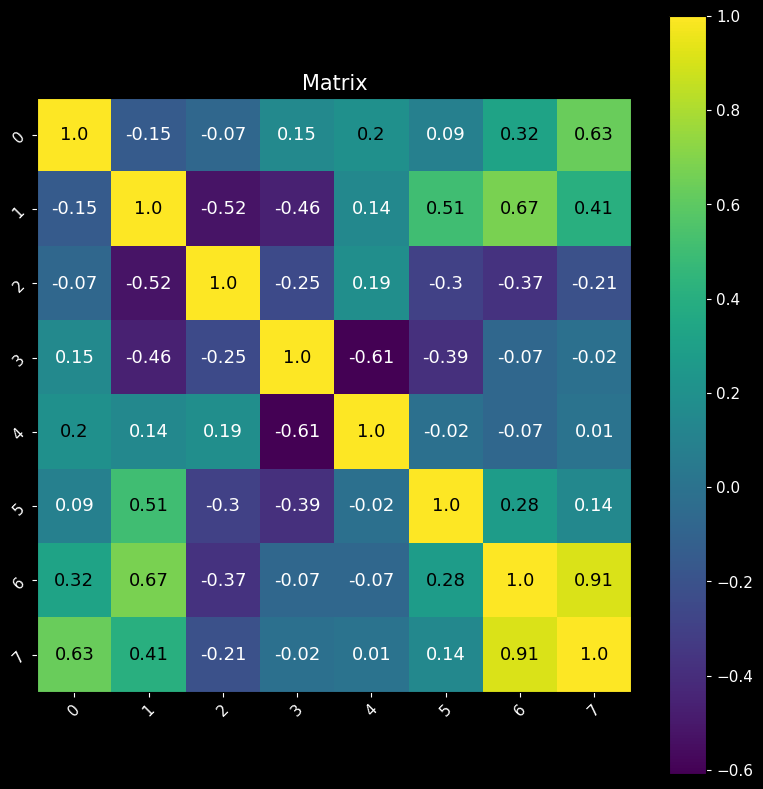

Centroids shape : (7, 32) - labels shape : (262144,) - Frame pred shape : (64, 64, 64)
Rand score             : 0.9489
Adjusted Rand score    : 0.8956
F1 score (avg = 0.8388) : ['0.979', '0.231', '0.924', '0.966', '0.881', '0.966', '0.925']
Silhouette score       : 0.7200


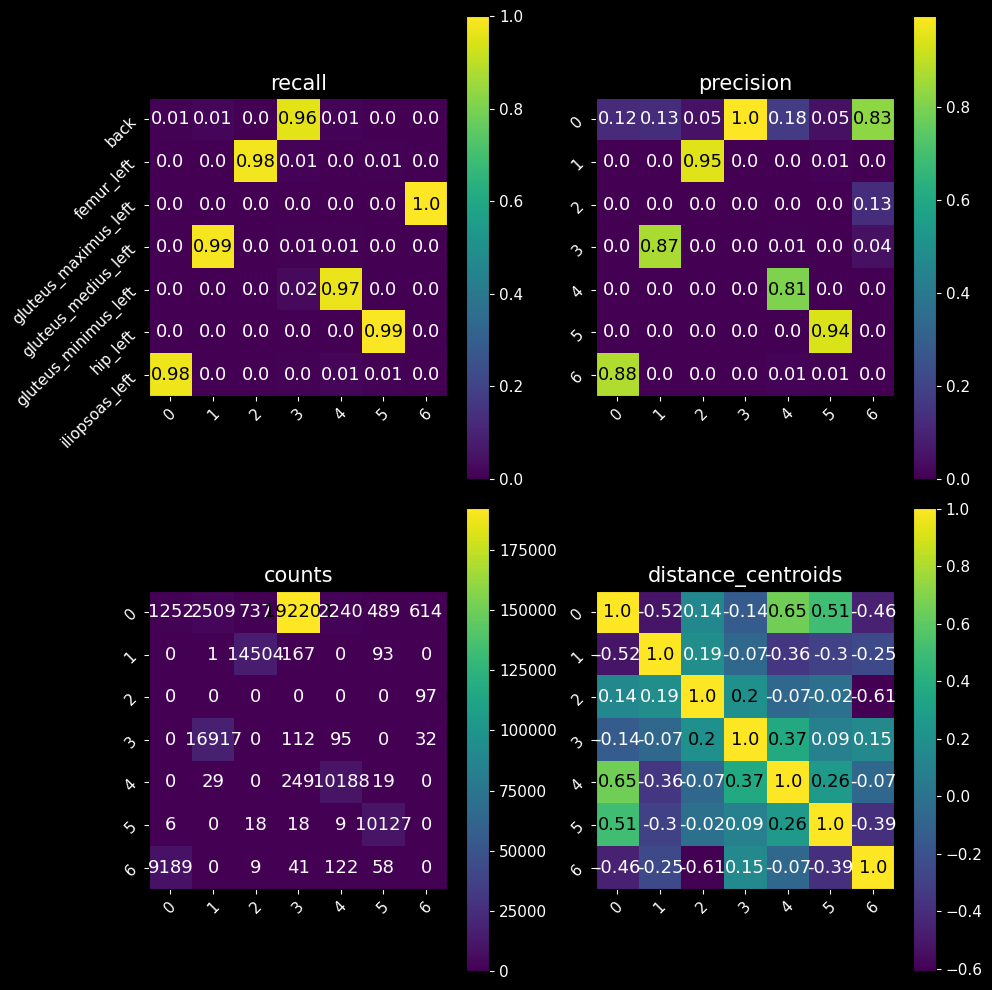

Organs matrix shape : (12420, 12420)


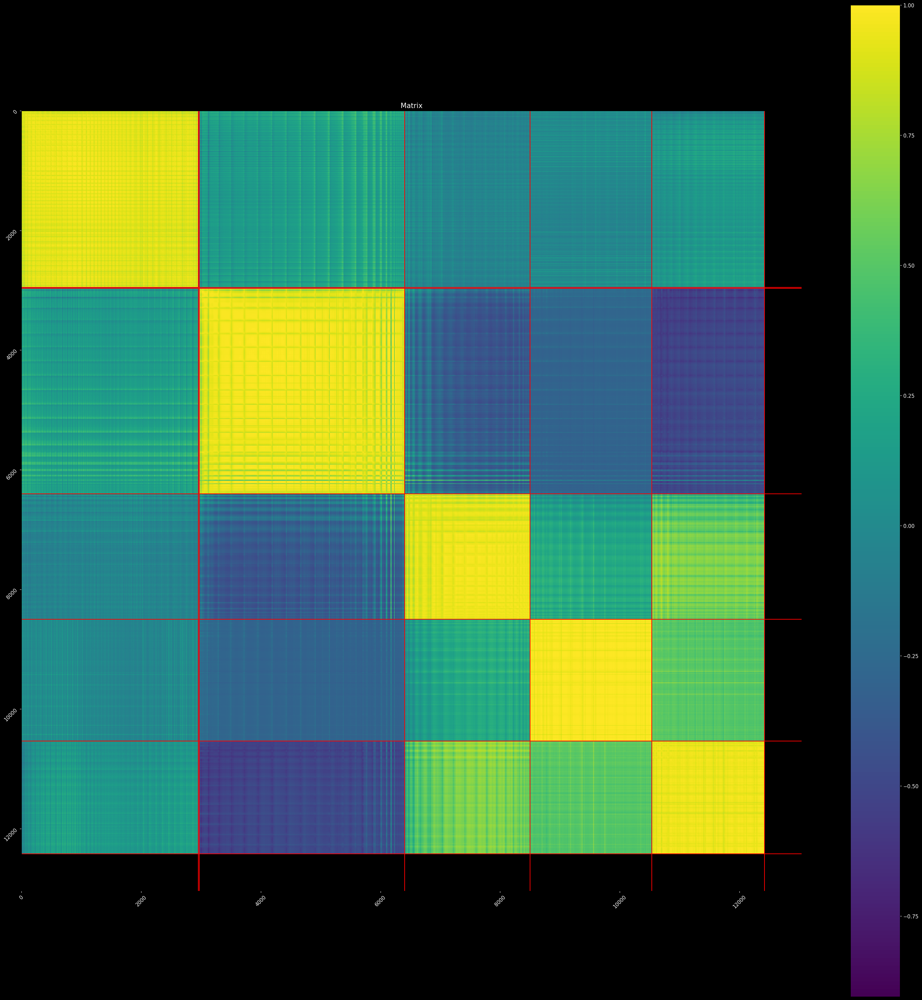


Analysis of patch [0 : 64, 64 : 128, 64 : 128]
Labels (n = 7) : [ 0  9 18 20 27 35 76]
Re-computing centroids by decreasing the k


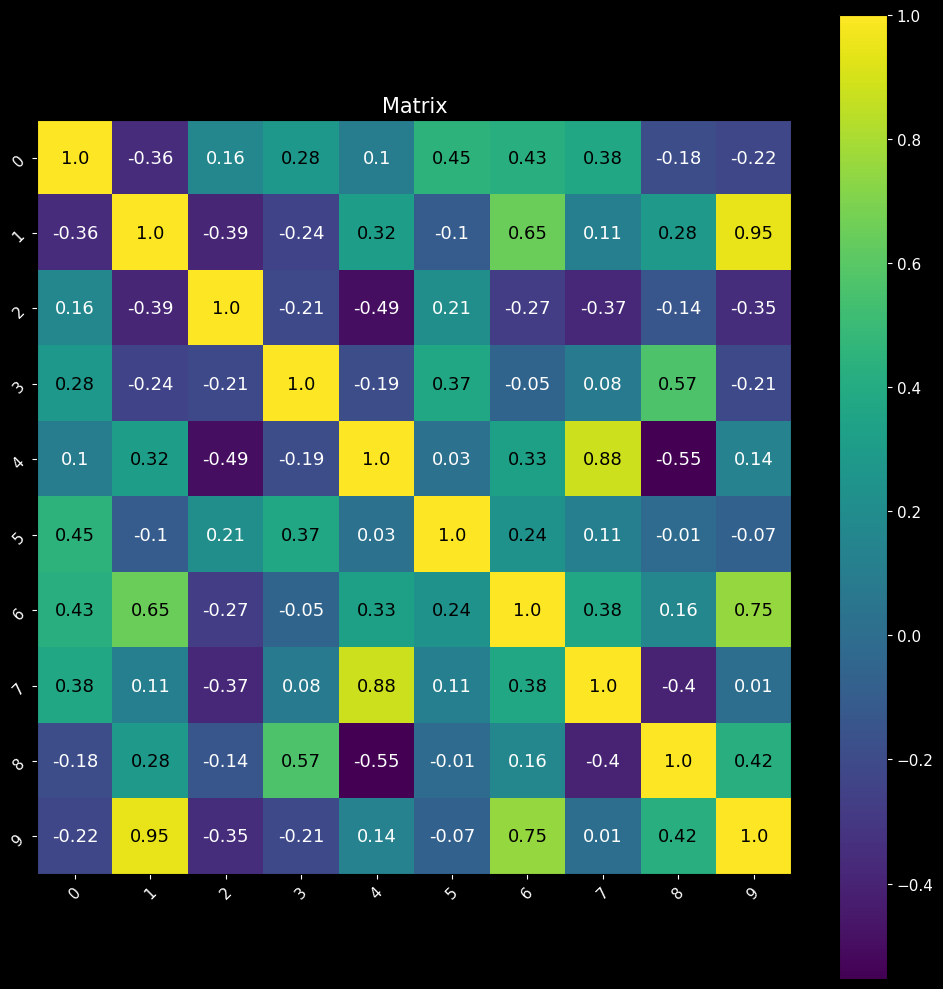

Re-computing centroids by decreasing the k


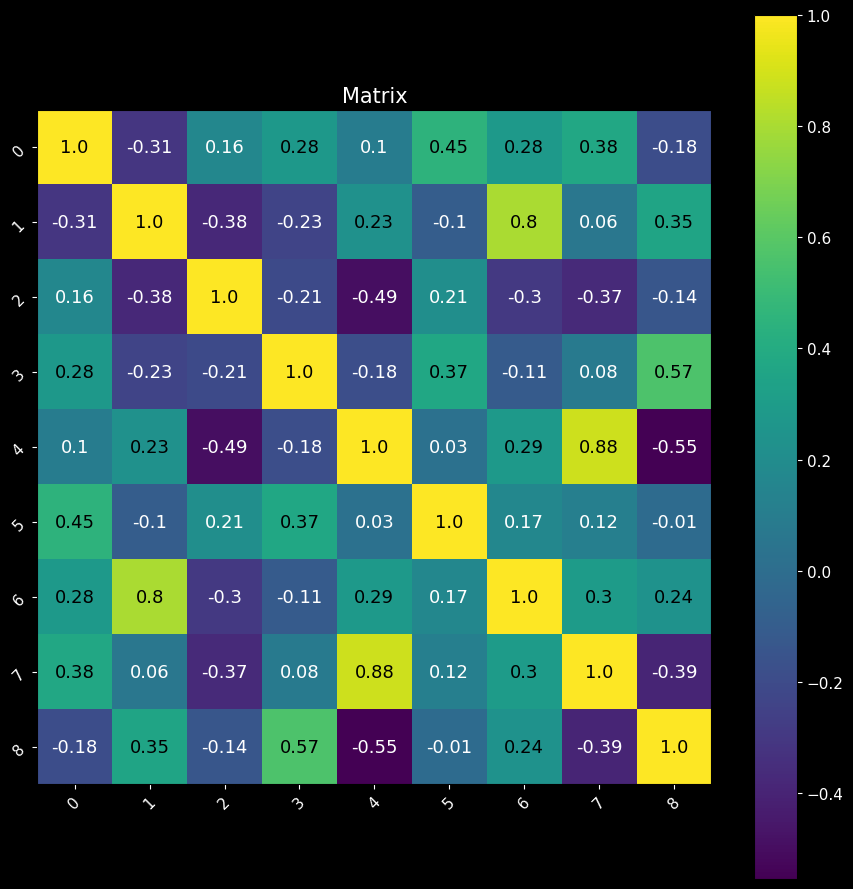

Re-computing centroids by decreasing the k


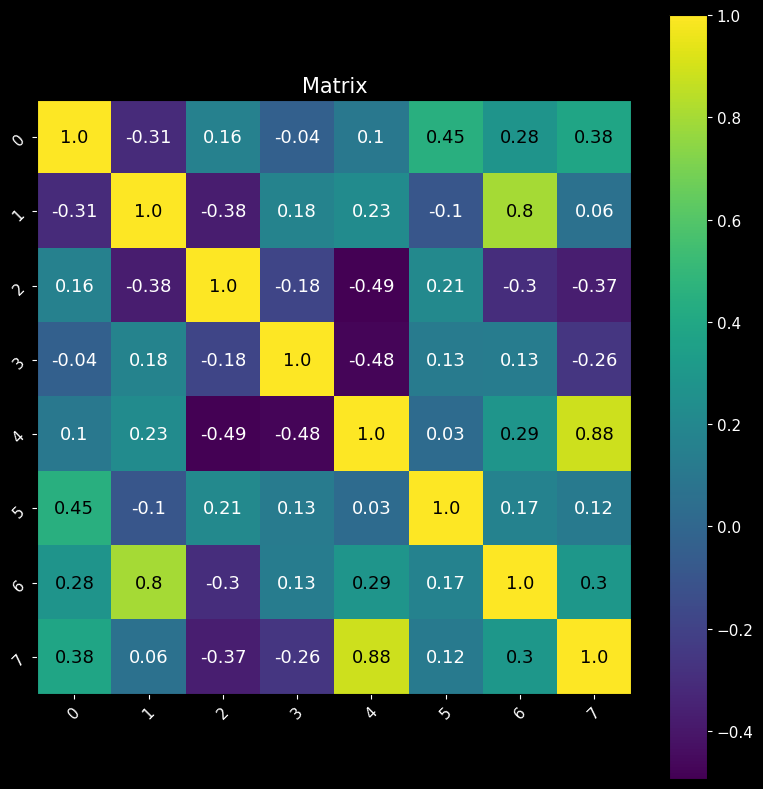

Centroids shape : (7, 32) - labels shape : (262144,) - Frame pred shape : (64, 64, 64)
Rand score             : 0.9575
Adjusted Rand score    : 0.9091
F1 score (avg = 0.7772) : ['0.985', '0.938', '0.741', '0.884', '0.000', '0.946', '0.947']
Silhouette score       : 0.7939


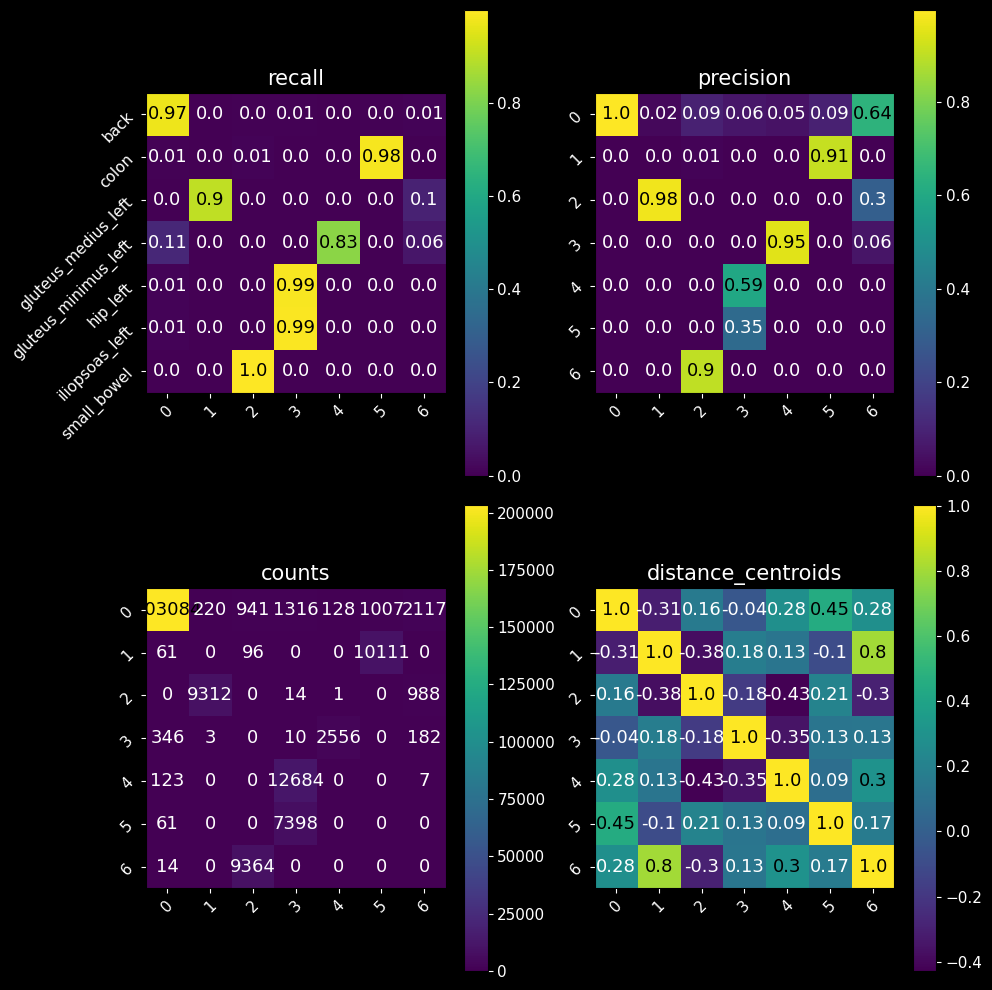

Organs matrix shape : (10667, 10667)


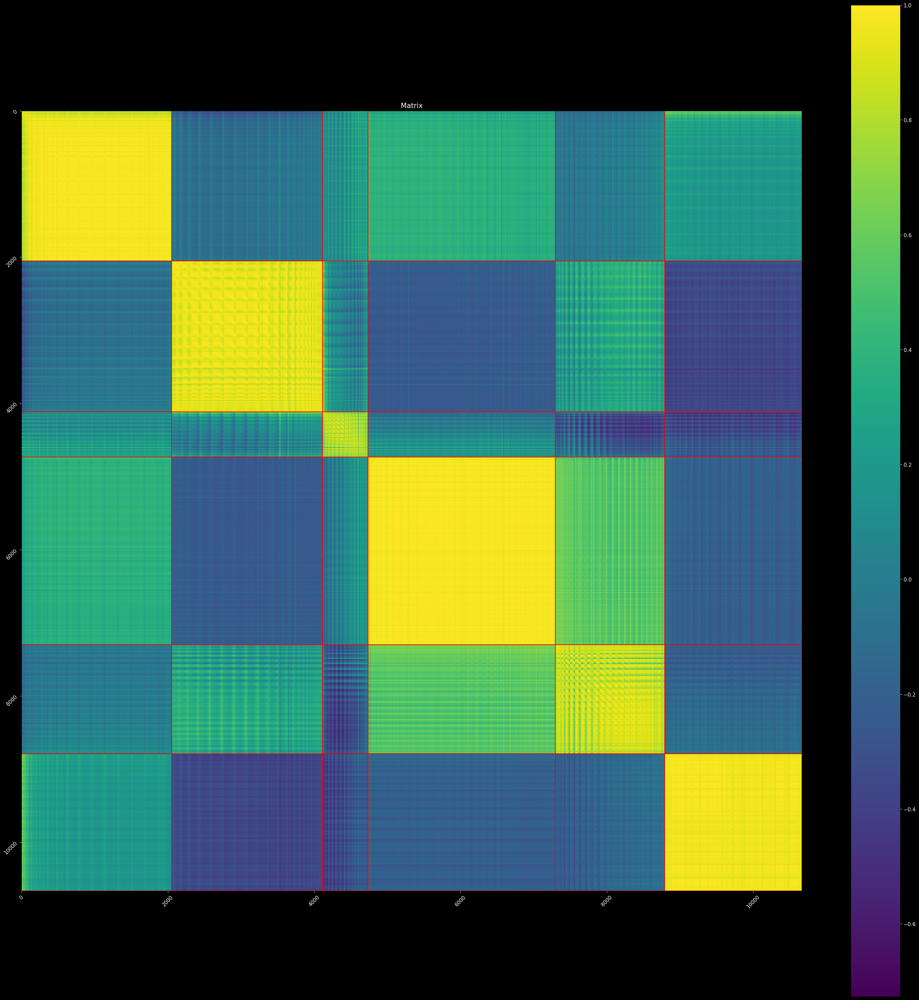

In [5]:
from utils.distance.clustering import *

def classify(classifier, frame_emb_flat, n_labels, k = None):
    if classifier == 'kmeans':
        if not k: k = n_labels + 3
        centroids, labels = kmeans(
            frame_emb_flat, k = range(max(3, n_labels - 3), n_labels + 3) if not k else k, distance_metric = model.distance_metric, normalize = True, n_init = 2, max_iter = 250
        )
    elif classifier == 'gaussian_mixture':
        gaussian = GaussianMixture(
            n_components = n_labels if not k else k, covariance_type = 'diag', init_params = 'k-means++'
        ).fit(frame_emb_flat)
        labels   = tf.cast(gaussian.predict(frame_emb_flat), tf.int32)
        _, centroids = compute_centroids(frame_emb_flat, labels)
    
    return centroids, labels

def analyze_patch(x0, x1, y0, y1, z0, z1, classifier = 'kmeans'):
    print('Analysis of patch [{} : {}, {} : {}, {} : {}]'.format(x0, x1, y0, y1, z0, z1))
    frame_inp = inputs[0, x0 : x1, y0 : y1, z0 : z1, 0]
    frame_tar = mask[x0 : x1, y0 : y1, z0 : z1]
    frame_emb = tf.cast(pred[0, x0 : x1, y0 : y1, z0 : z1], tf.float32)

    frame_inp_flat = tf.reshape(frame_inp, [-1])
    frame_tar_flat = np.reshape(frame_tar, [-1])
    frame_emb_flat = tf.reshape(frame_emb, [-1, frame_emb.shape[-1]])

    sorted_indexes = tf.argsort(frame_tar_flat).numpy()

    uniques  = np.unique(frame_tar_flat)
    n_labels = len(uniques)
    print('Labels (n = {}) : {}'.format(len(uniques), uniques))

    if n_labels == 1: return False
    
    """
    scores = []
    for k in tqdm(range(3, n_labels + 5)):
        centroids, labels = kmeans(
            frame_emb_flat, k = k, distance_metric = model.distance_metric, n_init = 2, normalize = True
        )
        scores.append(compute_score(
            frame_emb_flat, labels, centroids, np.arange(len(centroids)).astype(np.int32),
            distance_metric = model.distance_metric, normalize = True
        ))
    plot(range(3, n_labels + 5), scores, vlines = n_labels)
    """
    
    threshold = 0.85
    centroids, labels = classify(
        classifier, frame_emb_flat, n_labels
    )

    centroids_sim = distance(centroids, centroids, model.distance_metric, as_matrix = True, force_distance = False)
    while any(np.any(centroids_sim[i, :i] >= threshold) for i in range(1, len(centroids))):
        print('Re-computing centroids by decreasing the k')
        plot_matrix(centroids_sim)
        centroids, labels = classify(
            classifier, frame_emb_flat, n_labels, k = len(centroids) - 1
        )
        centroids_sim = distance(centroids, centroids, model.distance_metric, as_matrix = True, force_distance = False)
   
    frame_pred = tf.reshape(labels, frame_tar.shape)
    print('Centroids shape : {} - labels shape : {} - Frame pred shape : {}'.format(
        centroids.shape, labels.shape, frame_pred.shape
    ))
    
    frame_tar_flat_sorted = frame_tar_flat[sorted_indexes]
    frame_emb_flat_sorted = tf.cast(frame_emb_flat.numpy()[sorted_indexes], tf.float32)

    counts = np.bincount(frame_tar_flat_sorted)
    counts = counts[counts > 0]
    lines  = np.cumsum(counts)
    
    avg_f1, f1 = evaluate_clustering(frame_tar_flat, labels)
    print('Rand score             : {:.4f}'.format(rand_score(frame_tar_flat, labels)))
    print('Adjusted Rand score    : {:.4f}'.format(adjusted_rand_score(frame_tar_flat, labels)))
    print('F1 score (avg = {:.4f}) : {}'.format(float(avg_f1), ['{:.3f}'.format(float(f1_i)) for f1_i in f1]))
    print('Silhouette score       : {:.4f}'.format(silhouette_score(frame_emb_flat, frame_tar_flat, sample_size = 1000)))
    cm = confusion_matrix(frame_tar_flat, labels)
    valids = np.where(cm.sum(axis = -1) > 0)[0]
    cm = cm[valids]
    cm = cm[:, : len(centroids)]
    
    y_labels = [(['back'] + organs)[i] for i in uniques]
    plot_multiple(
        recall    = {'x' : cm / cm.sum(axis = -1, keepdims = True), 'y_labels' : y_labels},
        precision = {'x' : cm / cm.sum(axis = 0)},
        counts    = cm,
        distance_centroids = distance(centroids, centroids, model.distance_metric, as_matrix = True, force_distance = False),
        plot_type = 'matrix', factor_size = 0.8, use_subplots = True, ncols = 2
    )
    
    if (x1 - x0) * (y1 - y0) * (z1 - z0) < 50000:
        matrix = distance(
            frame_emb_flat_sorted, frame_emb_flat_sorted, method = model.distance_metric,
            as_matrix = True, max_matrix_size = 1024 ** 2, force_distance = False
        ).numpy()

        print('matrix shape : {}'.format(matrix.shape))

        data = {'distance' : {'x' : matrix, 'vlines' : lines, 'hlines' : lines}}
        if n_labels > 1:
            data['organ_distances'] =  {
                'x' : matrix[counts[0] :, counts[0] :], 'vlines' : np.cumsum(counts[1:]), 'hlines' : np.cumsum(counts[1:])
            }
        plot_matrix(
            matrix[::2, ::2], vlines = lines // 2, hlines = lines // 2
        )

    with tf.device('cpu'):
        organs_embed = frame_emb_flat_sorted[counts[0] :]
        organs_embed = organs_embed[::5]
        organs_matrix = distance(
            organs_embed, organs_embed, method = model.distance_metric,
            as_matrix = True, max_matrix_size = -1, force_distance = False
        ).numpy()
    print('Organs matrix shape : {}'.format(organs_matrix.shape))
    plot_matrix(
        organs_matrix, hlines = np.cumsum(counts[1:]) // 5, vlines = np.cumsum(counts[1:]) // 5
    )
    print()
    return True

step_x, step_y, step_z, i = 64, 64, 64, 0
for start_x in range(0, mask.shape[0], step_x):
    for start_y in range(0, mask.shape[1], step_y):
        for start_z in range(0, mask.shape[2], step_z):
            if i > 5: break
            if analyze_patch(start_x, start_x + step_x, start_y, start_y + step_y, start_z, start_z + step_z, 'kmeans'):
                i += 1

## Tests with expansion

In [3]:
row    = dataset.loc[0]

inputs, output = model.encode_data(row)
inputs = tf.expand_dims(inputs, axis = 0)
#image  = tf.expand_dims(model.get_input(row), axis = 0)
#target = model.get_output(row)
with tf.device('cpu'):
    mask = tf.argmax(tf.pad(tf.sparse.to_dense(output), [(0, 0), (0, 0), (0, 0), (1, 0)]), axis = -1).numpy()

print('Input shape : {} - Target shape : {} - Mask shape : {}'.format(inputs.shape, output.shape, mask.shape))

pred = model.infer(inputs, 64)

print('Prediction shape : {}'.format(pred.shape))

Input shape : (1, 249, 188, 213, 1) - Target shape : (249, 188, 213, 104) - Mask shape : (249, 188, 213)


2023-05-05 11:23:21.625302: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8204


Prediction shape : (1, 249, 188, 213, 32)


In [10]:
def get_stats(array):
    if len(array) == 0: return '/'
    return 'min : {:.3f} - max : {:.3f} - mean : {:.3f}'.format(
        np.min(array), np.max(array), np.mean(array)
    )

def dilate_and_predict(mask, pred, embeddings, threshold = 0.9, use_centroid = False):
    dilated    = ndimage.binary_dilation(mask)
    x, y, z = np.where(np.logical_and(dilated, np.logical_not(mask)))
    
    logger.debug('# new points : {}'.format(len(x)))
    queries    = tf.cast(pred[x, y, z], tf.float32)
    reference  = tf.reduce_mean(embeddings, axis = 0, keepdims = True) if use_centroid else embeddings
    logger.debug('Queries shape : {}'.format(queries.shape))
    
    distances  = tf_distance(
        queries, reference, model.distance_metric, as_matrix = True, force_distance = False, max_matrix_size = 1024 ** 2
    )
    logger.debug('Distances shape : {}'.format(distances.shape))
    distances = tf.reduce_mean(distances, axis = -1)
    selected  = distances >= threshold
    
    distances = distances.numpy()
    f_mask  = target_mask[x, y, z] == 0
    fp_mask = np.logical_and(selected, f_mask)
    tp_mask = np.logical_and(selected, ~f_mask)
    fn_mask = np.logical_and(~selected, ~f_mask)
    print('# tp : {} - fp {} - fn : {}'.format(np.sum(tp_mask), np.sum(fp_mask), np.sum(fn_mask)))
    print('Avg score for\n- TP : {}\n- FP : {}\n- FN : {}'.format(
        get_stats(distances[tp_mask]), get_stats(distances[fp_mask]), get_stats(distances[fn_mask])
    ))
    
    logger.debug('# selected : {}'.format(np.sum(selected)))
    embeddings = tf.concat([embeddings, tf.boolean_mask(queries, selected)], axis = 0)
    logger.debug('New embeddings shape : {}'.format(embeddings.shape))
    
    unselected = np.logical_not(selected)
    dilated[x[unselected], y[unselected], z[unselected]] = 0
    return dilated, embeddings

target_organ = 4
target_mask  = mask == target_organ

x, y, z = np.where(target_mask)
print('# points : {}'.format(len(x)))
idx     = np.random.choice(len(x))
x, y, z = x[idx], y[idx], z[idx]

pred_mask = np.zeros(mask.shape, dtype = np.uint8)
pred_mask[x, y, z] = 1

embeddings = tf.cast(tf.expand_dims(pred[0, x, y, z], axis = 0), tf.float32)
for i in range(100):
    print('Step {}'.format(i + 1))
    last_embeddings = embeddings
    
    pred_mask, embeddings = dilate_and_predict(
        pred_mask, pred[0], embeddings, threshold = 0.9, use_centroid = False
    )
    tp = np.sum(np.logical_and(pred_mask, target_mask))
    fp = np.sum(np.logical_and(pred_mask, ~target_mask))
    print('TP : {} - FP : {}\n'.format(tp, fp))
    if len(embeddings) == len(last_embeddings):
        print('[STOP] At iteration {}'.format(i + 1))
        break

print('Dice score : {}'.format(
    2 * tp / (np.sum(target_mask) + np.sum(pred_mask))
))

# points : 74353
Step 1
# tp : 6 - fp 0 - fn : 0
Avg score for
- TP : min : 1.000 - max : 1.000 - mean : 1.000
- FP : /
- FN : /
TP : 7 - FP : 0

Step 2
# tp : 18 - fp 0 - fn : 0
Avg score for
- TP : min : 1.000 - max : 1.000 - mean : 1.000
- FP : /
- FN : /
TP : 25 - FP : 0

Step 3
# tp : 38 - fp 0 - fn : 0
Avg score for
- TP : min : 0.999 - max : 1.000 - mean : 1.000
- FP : /
- FN : /
TP : 63 - FP : 0

Step 4
# tp : 64 - fp 2 - fn : 0
Avg score for
- TP : min : 0.999 - max : 1.000 - mean : 1.000
- FP : min : 0.999 - max : 0.999 - mean : 0.999
- FN : /
TP : 127 - FP : 2

Step 5
# tp : 94 - fp 8 - fn : 0
Avg score for
- TP : min : 0.999 - max : 1.000 - mean : 1.000
- FP : min : 0.998 - max : 0.999 - mean : 0.999
- FN : /
TP : 221 - FP : 10

Step 6
# tp : 127 - fp 19 - fn : 0
Avg score for
- TP : min : 0.999 - max : 1.000 - mean : 1.000
- FP : min : 0.997 - max : 1.000 - mean : 0.999
- FN : /
TP : 348 - FP : 29

Step 7
# tp : 164 - fp 34 - fn : 0
Avg score for
- TP : min : 0.999 - max :

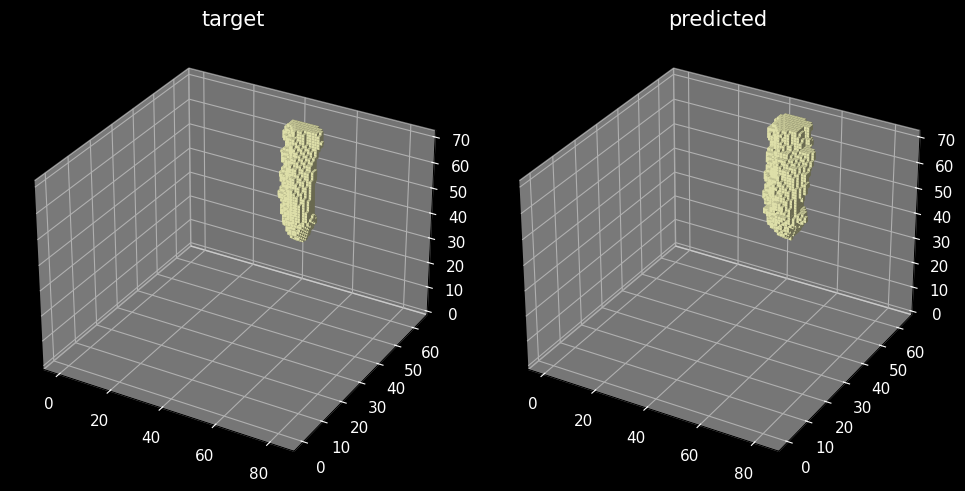

In [11]:
sx, sy, sz = -3, -3, 3
plot_multiple(
    target = {'x' : mask.copy(), 'labels_to_show' : [target_organ]},
    predicted = pred_mask.astype(np.int32), strides = (sx, sy, sz),
    plot_type = 'volume', plot_3d = True, ncols = 2, use_subplots = True, cmap = 'magma'
)
#plot_volume(mask.copy(), labels_to_show = [3], strides = (sx, sy, sz))
#plot_volume(pred_mask.astype(np.int32), strides = (sx, sy, sz))

In [ ]:
with tf.device('cpu'):
    plot_matrix(tf_distance(
        embeddings, embeddings, model.distance_metric, as_matrix = True, max_matrix_size = 1024 ** 2
    ).numpy(), norm = False)

In [24]:
possible_organs = [(i, organs[i - 1]) for i in np.unique(mask) if i > 0]
possible_organs

[(1, 'adrenal_gland_left'),
 (2, 'adrenal_gland_right'),
 (3, 'aorta'),
 (4, 'autochthon_left'),
 (5, 'autochthon_right'),
 (9, 'colon'),
 (10, 'duodenum'),
 (13, 'femur_left'),
 (14, 'femur_right'),
 (16, 'gluteus_maximus_left'),
 (17, 'gluteus_maximus_right'),
 (18, 'gluteus_medius_left'),
 (19, 'gluteus_medius_right'),
 (20, 'gluteus_minimus_left'),
 (21, 'gluteus_minimus_right'),
 (27, 'hip_left'),
 (28, 'hip_right'),
 (31, 'iliac_artery_left'),
 (32, 'iliac_artery_right'),
 (33, 'iliac_vena_left'),
 (34, 'iliac_vena_right'),
 (35, 'iliopsoas_left'),
 (36, 'iliopsoas_right'),
 (37, 'inferior_vena_cava'),
 (38, 'kidney_left'),
 (39, 'kidney_right'),
 (40, 'liver'),
 (41, 'lung_lower_lobe_left'),
 (42, 'lung_lower_lobe_right'),
 (43, 'lung_middle_lobe_right'),
 (46, 'pancreas'),
 (47, 'portal_vein_and_splenic_vein'),
 (50, 'rib_left_10'),
 (51, 'rib_left_11'),
 (52, 'rib_left_12'),
 (59, 'rib_left_8'),
 (60, 'rib_left_9'),
 (62, 'rib_right_10'),
 (63, 'rib_right_11'),
 (64, 'rib_righ

## Tests dilation

In [9]:
from scipy import ndimage

image = np.zeros((9, 9), dtype = np.uint8)
image[image.shape[0] // 2, len(image) // 2] = 1

filters = np.array([
    [0, 1, 0],
    [1, 1, 1],
    [0, 1, 0]
])
images = {'init' : image}
for i in range(3):
    image = ndimage.binary_dilation(image, filters)
    images['Step #{}'.format(i + 1)] = image


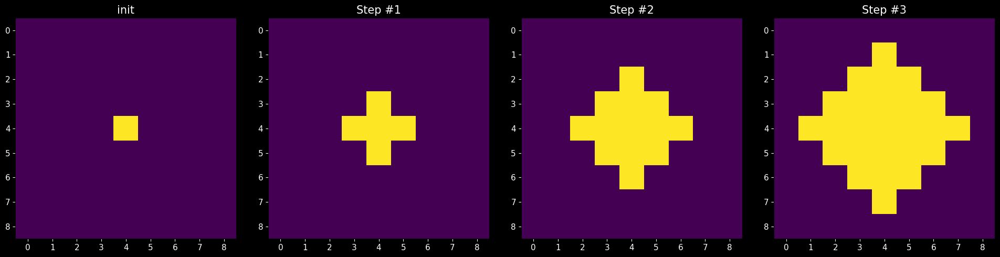

In [10]:
plot_multiple(** images, plot_type = 'imshow', ncols = len(images))

In [20]:
from scipy import ndimage

image = np.zeros((9, 9, 9), dtype = np.uint8)
image[image.shape[0] // 2, len(image) // 2, len(image) // 2] = 1

filters = np.zeros((3, 3, 3))
filters[1, 1, :] = 1
filters[1, :, 1] = 1
filters[:, 1, 1] = 1

images = {'init' : image}
for i in range(3):
    image = ndimage.binary_dilation(image, filters)
    images['Step #{} ({} items)'.format(i + 1, np.sum(image))] = image


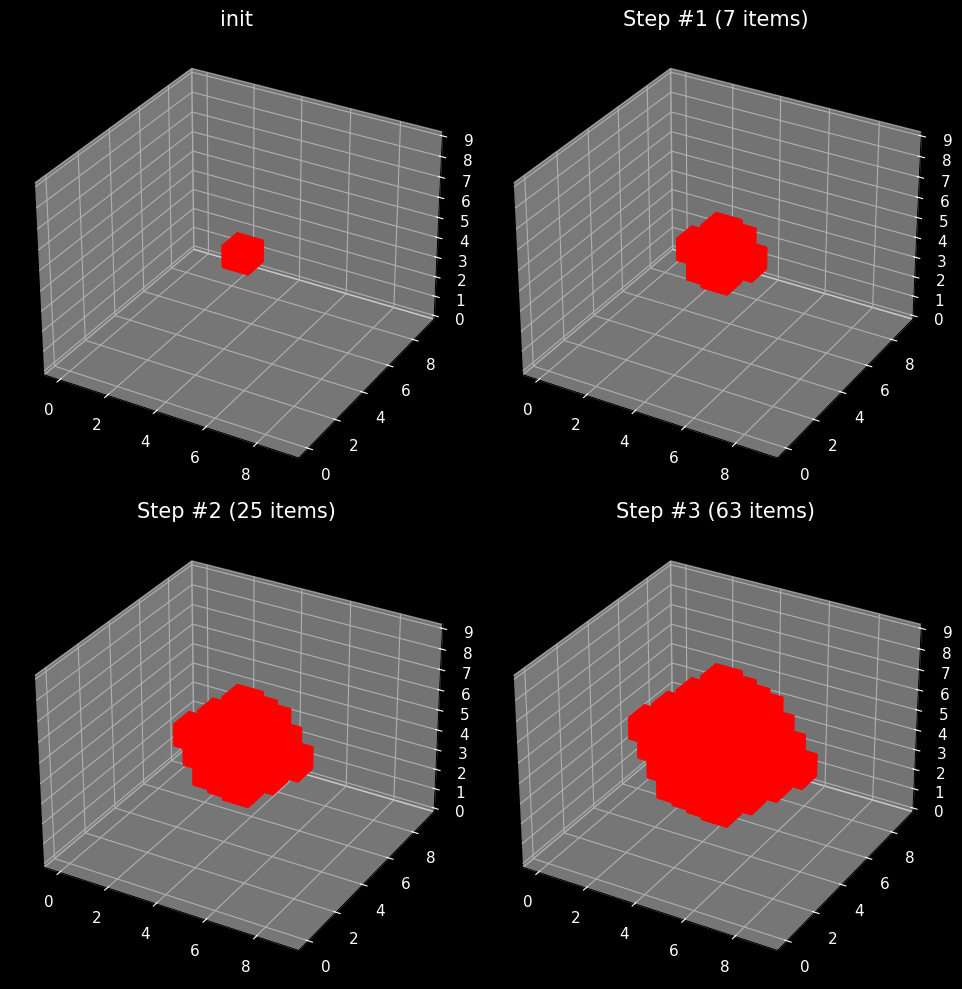

In [21]:
plot_multiple(** images, plot_type = 'voxels', ncols = len(images) // 2, plot_3d = True)